In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import scipy
import datetime
import seaborn as sns
sns.set_theme(style="whitegrid")
from subreddit_lists import mentalhealth_subreddits
from load_utils import get_author_posts_df, get_common_authors_posts
from processing_utils import preprocess_df, n_gram_freq, get_empath_data, get_nrclex_data, verb_count, noun_count, sfa_metrics
from plot import plot_wordcloud, plot_subjectivity, plot_polarity
from trend_utils import *
from author_utils import *
from textblob import TextBlob
from datetime import datetime
import statsmodels.api as sm

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\lawli\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\lawli\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\lawli\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\lawli\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [2]:
subreddit_1 = 'NevilleGoddard'
subreddit_2 = 'Nietzsche'

df_subreddit_1 = get_author_posts_df(subreddit_1)
df_subreddit_1 = get_common_authors_posts(df_subreddit_1, mentalhealth_subreddits, subreddit_1)

df_subreddit_2 = get_author_posts_df(subreddit_2)
df_subreddit_2 = get_common_authors_posts(df_subreddit_2, mentalhealth_subreddits, subreddit_2)

Number of unique authors : 624
Number of unique authors : 734


In [3]:
print(f"Posts from users from {subreddit_1} who post in mental health forums")
print("Dataframe shape: ",df_subreddit_1.shape)
df_subreddit_1.head()

Posts from users from NevilleGoddard who post in mental health forums
Dataframe shape:  (13943, 5)


,isodate,subreddit,author,body,source
147,2022-10-22 07:06:55,NevilleGoddard,DisastrousNight7229,Was looking for an outsider's perspective.,NevilleGoddard
148,2022-10-22 07:06:30,NevilleGoddard,DisastrousNight7229,Are you limiting contact with them? How do you...,NevilleGoddard
149,2022-10-22 05:13:46,Vindicta,DisastrousNight7229,It was a combination of things I believe. Main...,NevilleGoddard
150,2022-10-21 14:16:30,NevilleGoddard,DisastrousNight7229,Had no idea he talked about this. Thank you so...,NevilleGoddard
151,2022-10-21 13:45:52,Vindicta,DisastrousNight7229,This is most likely not what you mean by an un...,NevilleGoddard


In [4]:
print(f"Posts from users from {subreddit_2} who post in mental health forums")
print("Dataframe shape: ",df_subreddit_2.shape)
df_subreddit_2.head()

Posts from users from Nietzsche who post in mental health forums
Dataframe shape:  (30806, 5)


,isodate,subreddit,author,body,source
1159,2022-10-06 21:54:18,Nietzsche,slavetothegiven,yeh tried all the usual. but i thought it was ...,Nietzsche
1160,2022-09-02 20:27:23,realhousewives,slavetothegiven,what why on earth is dorit returning and erica...,Nietzsche
1161,2022-08-20 15:14:40,realhousewives,slavetothegiven,wait what did teddi say?,Nietzsche
1162,2022-08-20 15:10:18,realhousewives,slavetothegiven,wait when did Sutton mock her nationality?,Nietzsche
1163,2022-08-18 16:15:58,realhousewives,slavetothegiven,reality tv is all about getting clearly person...,Nietzsche


## Popular mental health subreddits amongst users

<AxesSubplot: xlabel='subreddit', ylabel='counts'>

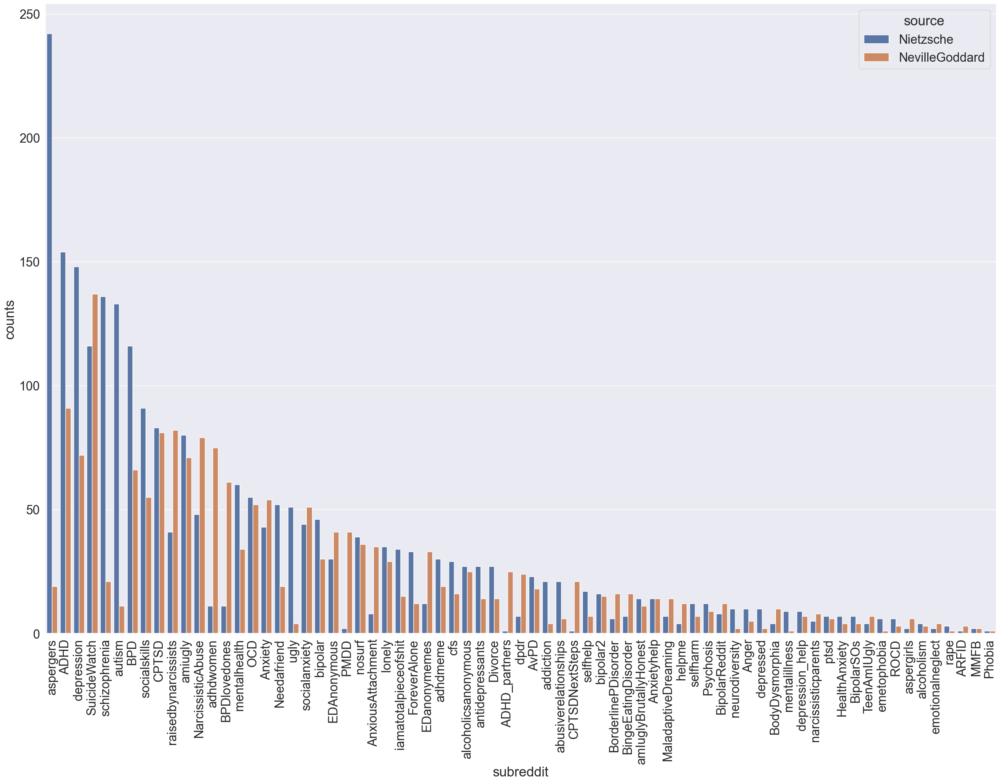

In [5]:
sub_counts_1 = df_subreddit_1.\
            groupby(by = ['subreddit', 'source']).\
            size().\
            reset_index(name = 'counts').\
            sort_values(by = 'counts', ascending = False)

sub_counts_2 = df_subreddit_2.\
            groupby(by = ['subreddit', 'source']).\
            size().\
            reset_index(name = 'counts').\
            sort_values(by = 'counts', ascending = False)

sub_counts = pd.concat([sub_counts_1, sub_counts_2], axis = 0)
sub_counts = sub_counts[sub_counts['subreddit'].isin(mentalhealth_subreddits)]
subs = sub_counts.groupby(by = 'subreddit').size().reset_index(name = 'sources')
subs = subs[subs['sources'] == 2]
sub_counts = sub_counts[sub_counts['subreddit'].isin(subs['subreddit'])].sort_values(by='counts', ascending = False)

sns.set(rc={'figure.figsize':(30,20)})
sns.set(font_scale=2)
plt.xticks(rotation=90)
sns.barplot(data=sub_counts, x= "subreddit", y= "counts", hue = "source")

The above plot shows the number of posts made into mental health subreddits by the users from the two groups. There are a few mental health subreddits that have comparable number of posts. Only those subreddits will be picked for further analysis and comparison.

Selected subreddits: ADHD, depression, BPD, socialskills, SuicideWatch, CPTSD, raisedbynarcissists, NarcissisticAbuse, OCD, Anxiety, socialanxiety

In [6]:
selected_subs = ["ADHD", "depression", "BPD", "socialskills", "SuicideWatch", "CPTSD",\
                 "raisedbynarcissists", "NarcissisticAbuse", "OCD", "Anxiety", "socialanxiety"]

df_subreddit_1 = get_author_posts_df(subreddit_1)
df_subreddit_1 = get_common_authors_posts(df_subreddit_1, selected_subs, subreddit_1)
df_subreddit_1 = preprocess_df(df_subreddit_1, f"{subreddit_1}/{subreddit_1}_comparison")

df_subreddit_2 = get_author_posts_df(subreddit_2)
df_subreddit_2 = get_common_authors_posts(df_subreddit_2, selected_subs, subreddit_2)
df_subreddit_2 = preprocess_df(df_subreddit_2, f"{subreddit_2}/{subreddit_2}_comparison")



Number of unique authors : 355
Number of unique authors : 391


Check if there are any common authors between the two forums

In [7]:
df = df_subreddit_2[df_subreddit_2['author'].isin(df_subreddit_1['author'])]
df['author'].nunique()

0

In [8]:
df = df_subreddit_1[df_subreddit_1['author'].isin(df_subreddit_2['author'])]
df['author'].nunique()

0

## N-gram and Wordcloud comparison

### Unigram comparison

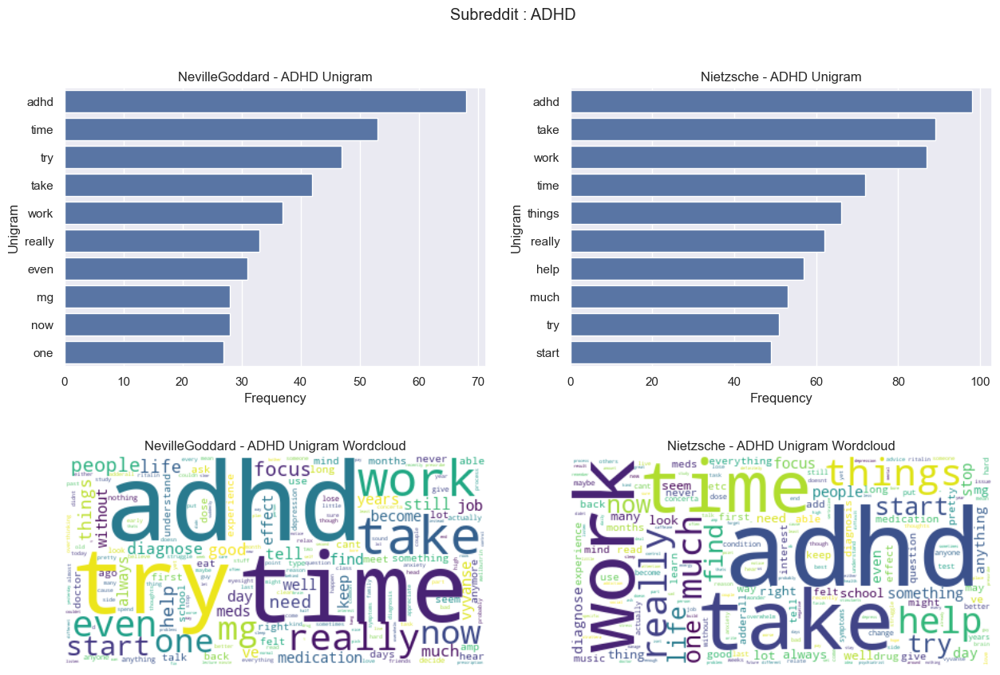

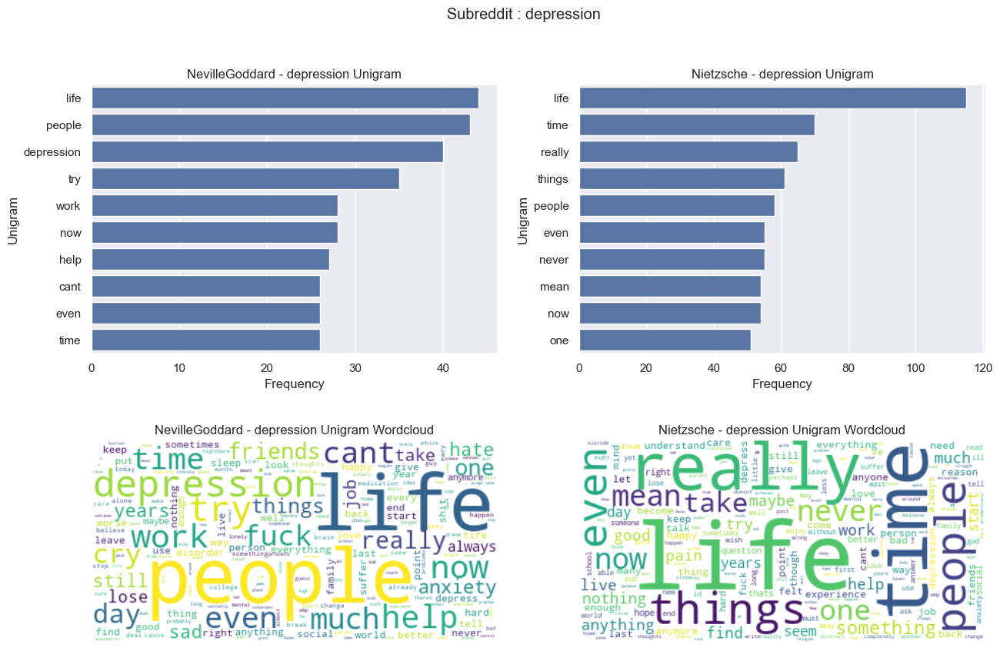

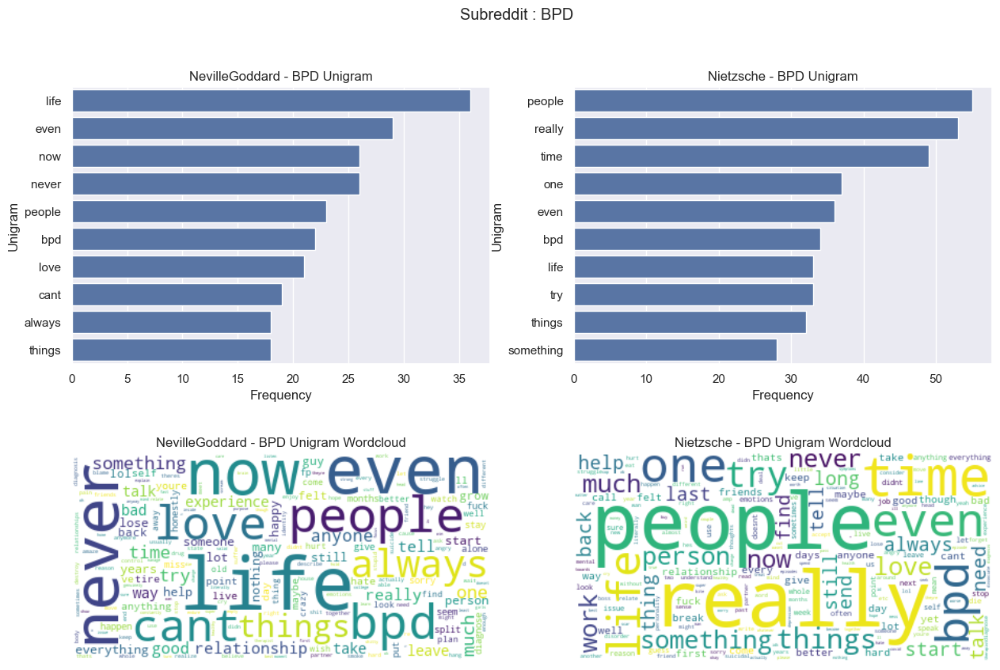

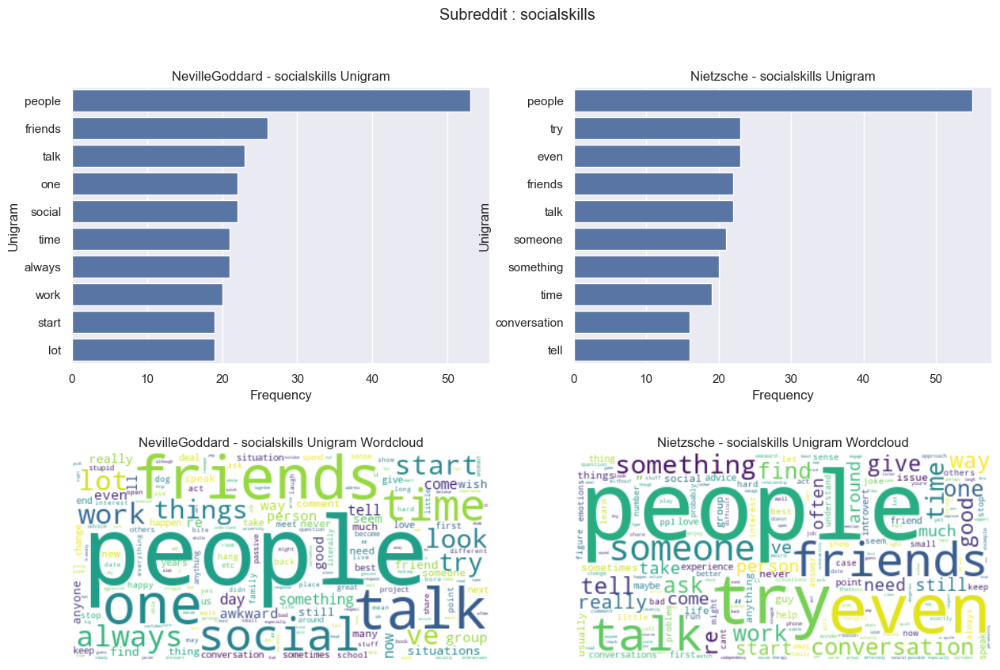

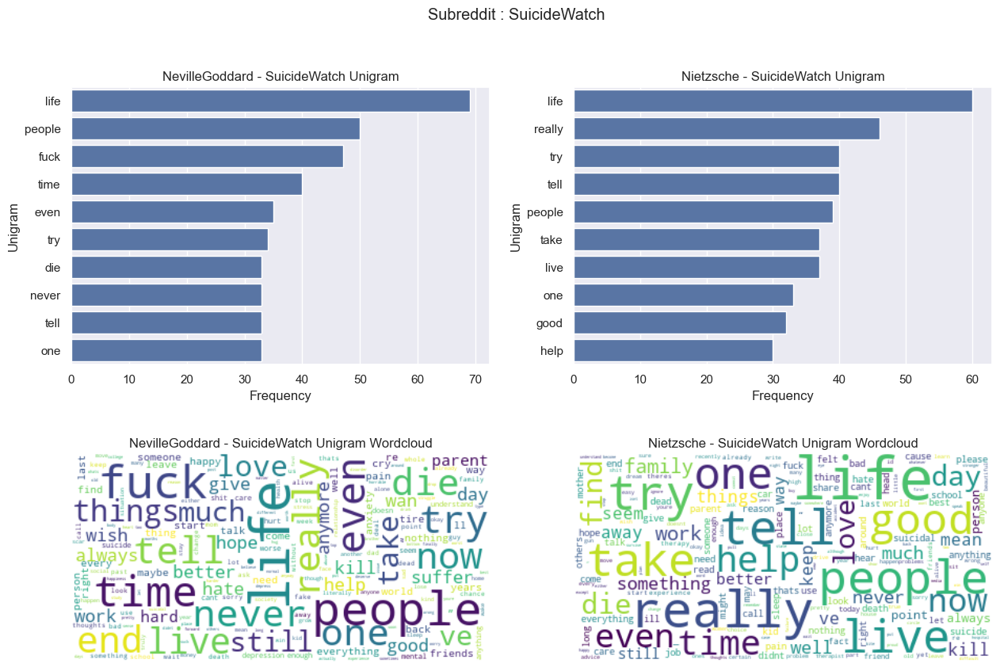

...

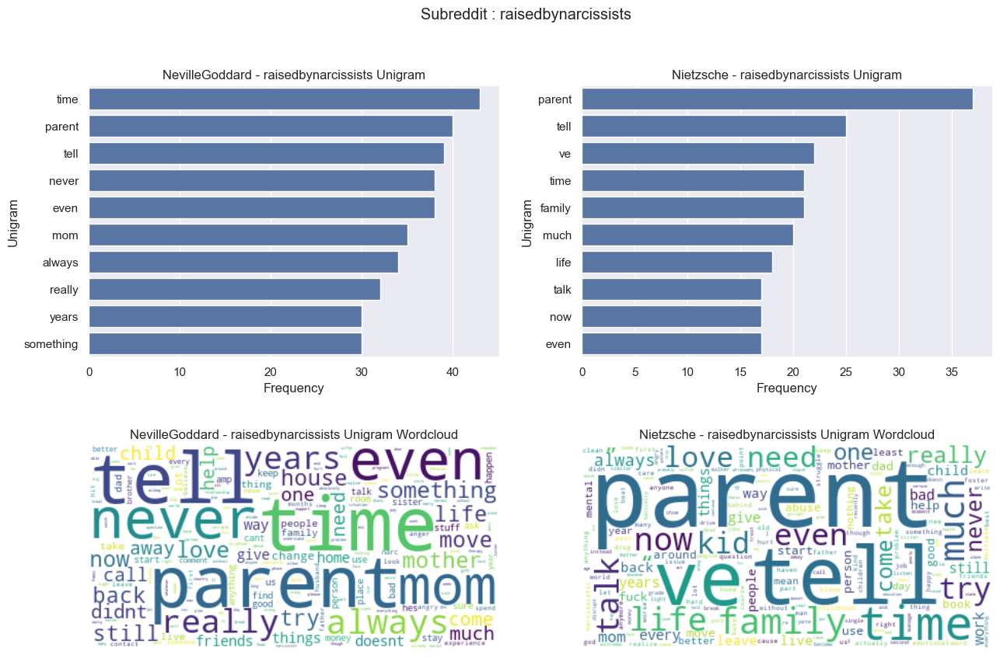

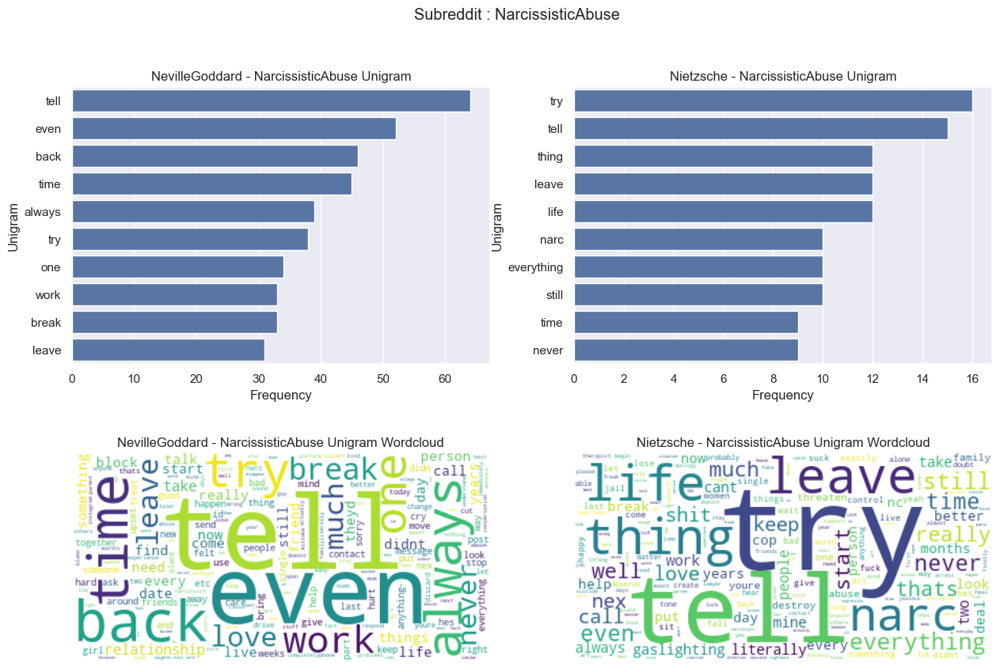

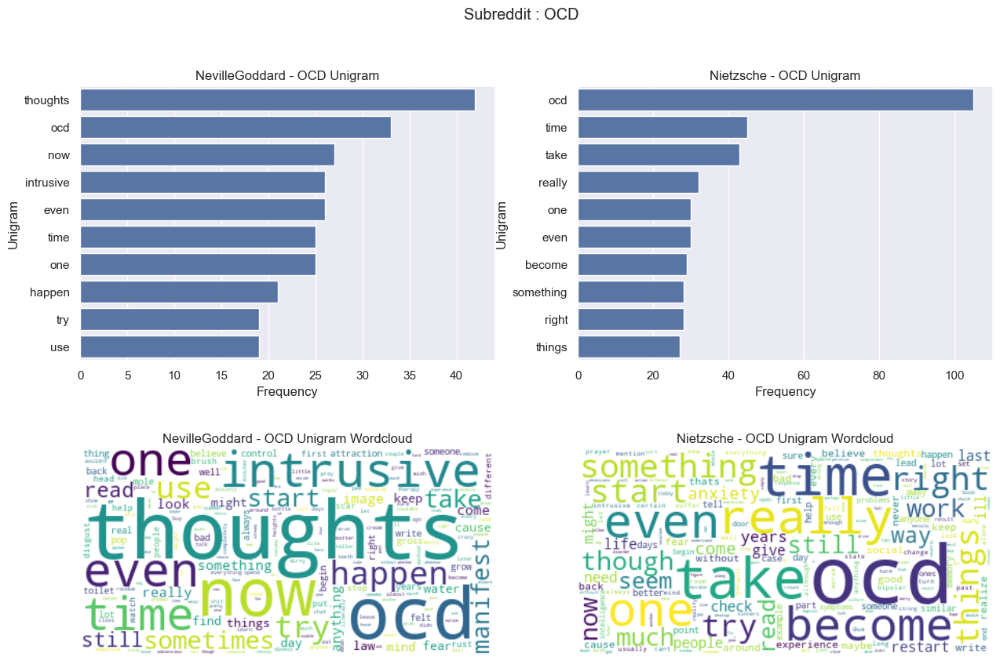

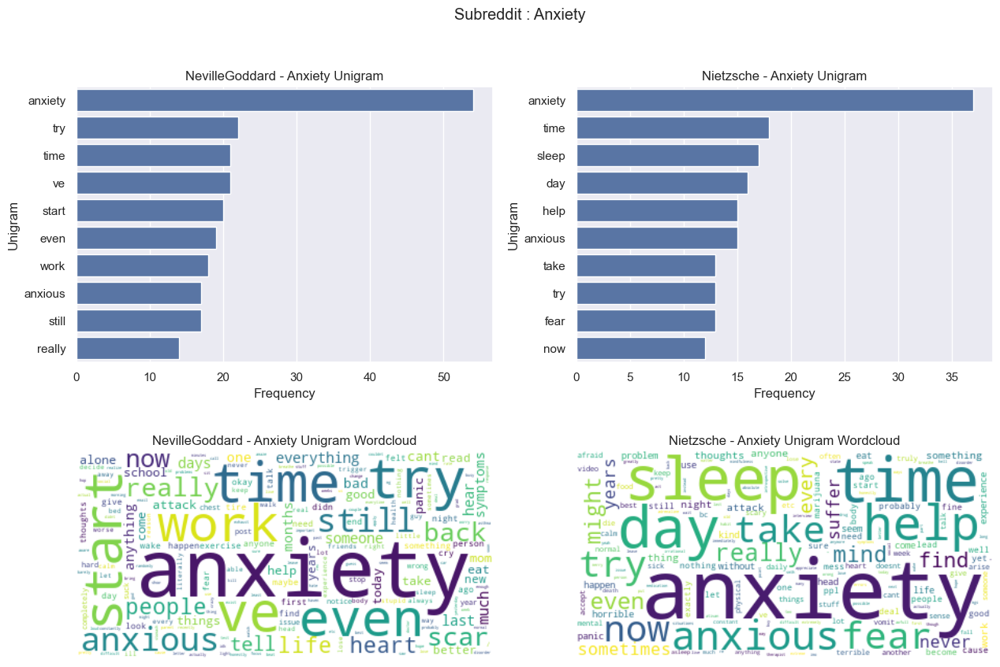

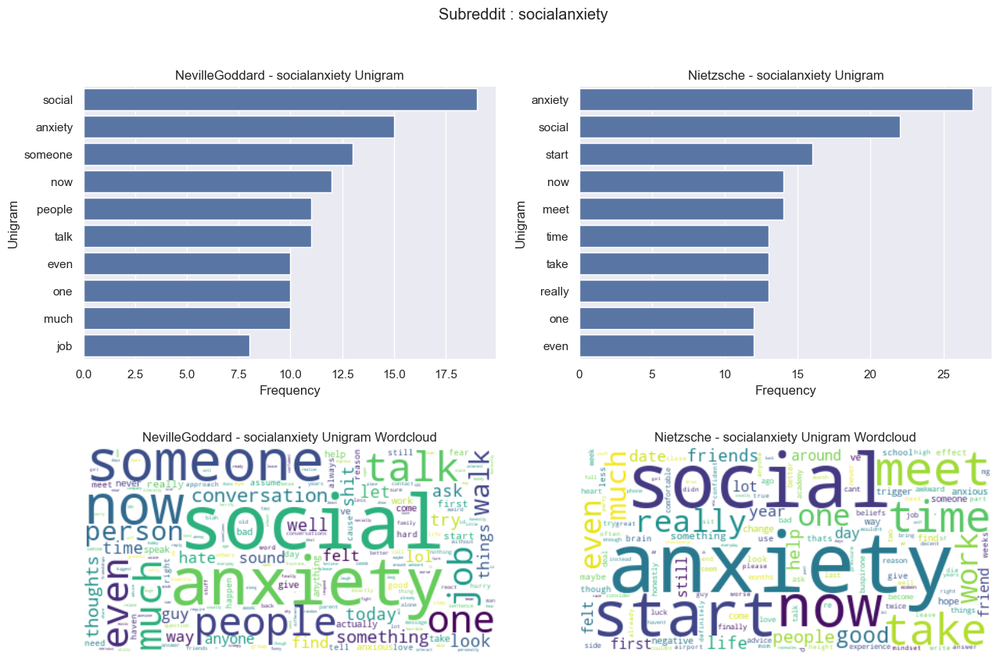

In [9]:
sns.set_color_codes("pastel")
sns.set(rc={'figure.figsize':(15,10)})

for sub in selected_subs:
    unigram_freq_df_1 = n_gram_freq(df_subreddit_1[df_subreddit_1['subreddit']==sub],1)
    unigram_freq_df_2 = n_gram_freq(df_subreddit_2[df_subreddit_2['subreddit']==sub],1)
    
    fig, axs = plt.subplots(nrows= 2, ncols=2)
    fig.suptitle(f'Subreddit : {sub}')
    
    axs[0,0].set_title(f"{subreddit_1} - {sub} Unigram")
    sns.barplot(x="Frequency", y="Unigram", data=unigram_freq_df_1.head(10), color="b", ax= axs[0,0])
    
    axs[0,1].set_title(f"{subreddit_2} - {sub} Unigram")
    sns.barplot(x="Frequency", y="Unigram", data=unigram_freq_df_2.head(10), color="b", ax = axs[0,1])
    
    plt.subplot(2,2,3)
    plot_wordcloud(unigram_freq_df_1, f"{subreddit_1} - {sub} Unigram")
    
    plt.subplot(2,2,4)
    plot_wordcloud(unigram_freq_df_2, f"{subreddit_2} - {sub} Unigram")
    

### Bigram comparison

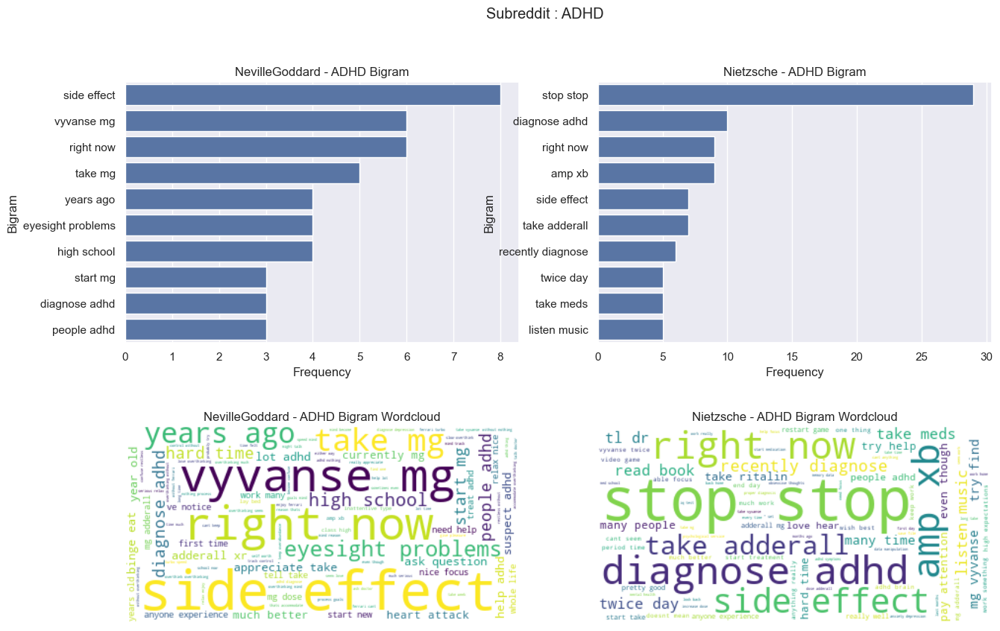

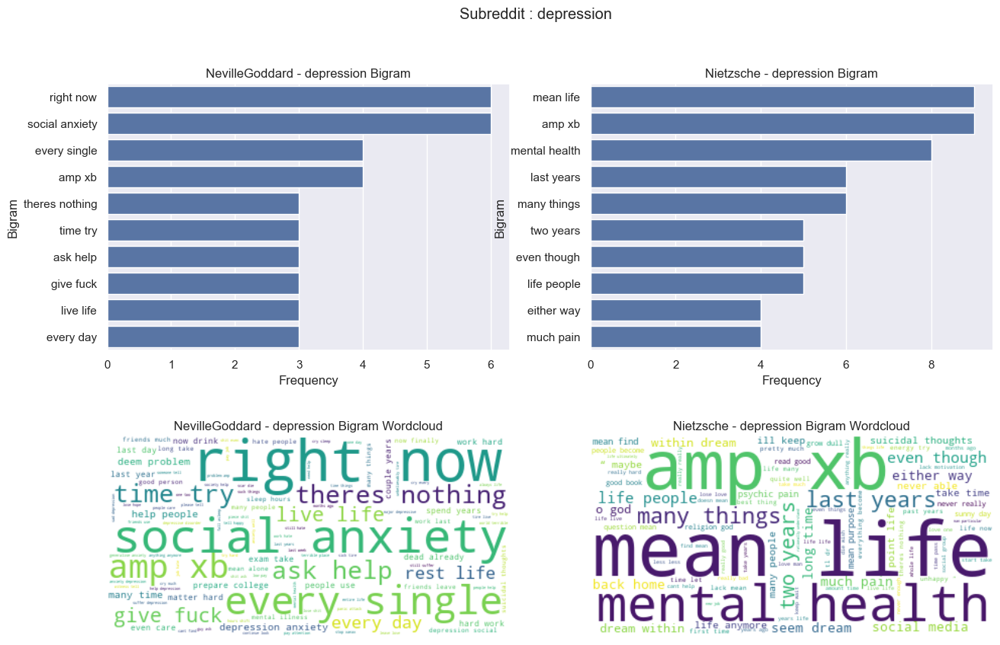

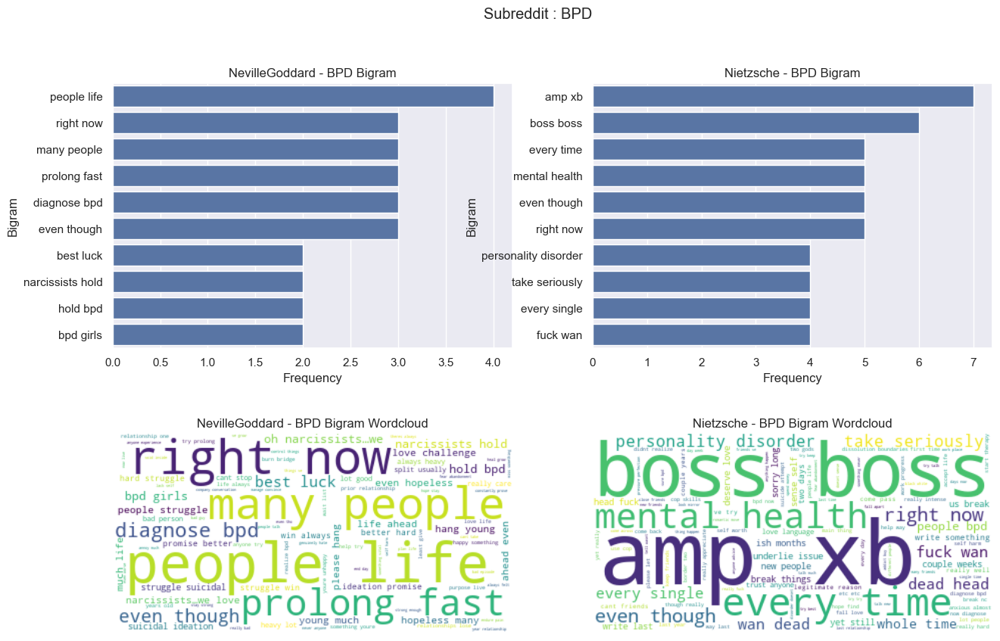

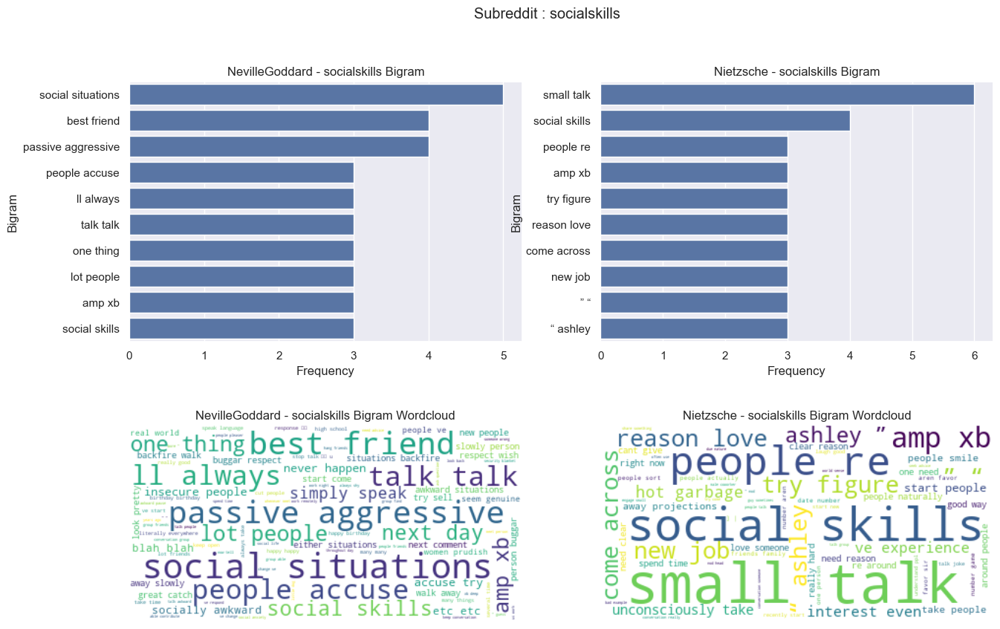

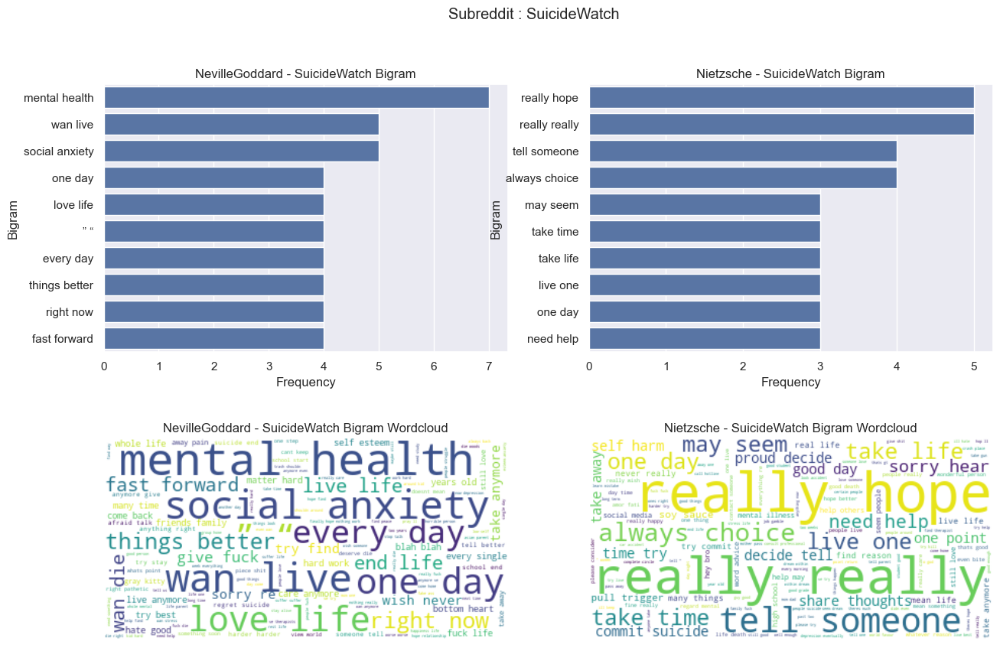

...

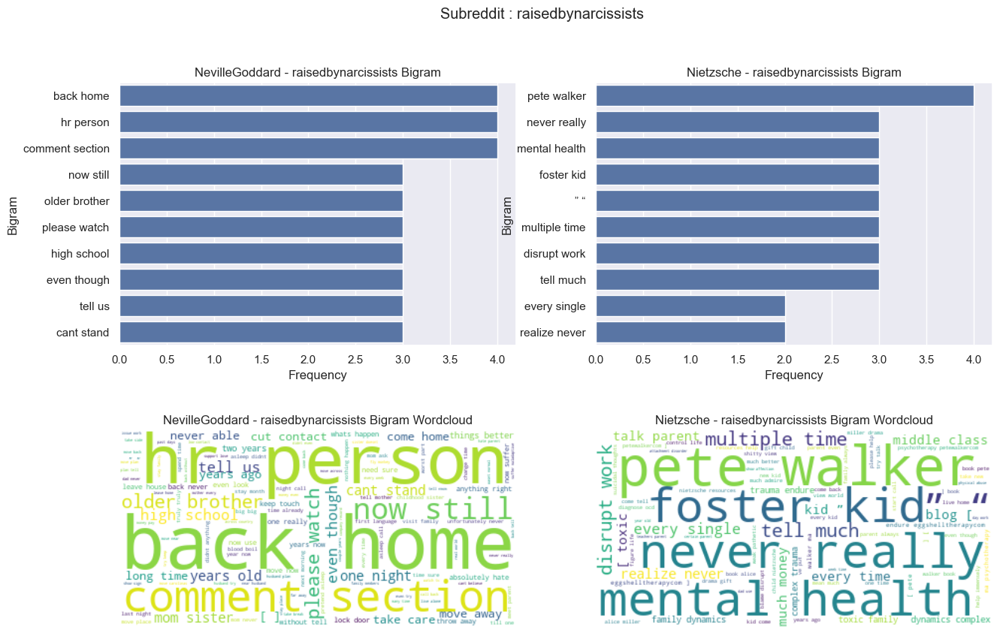

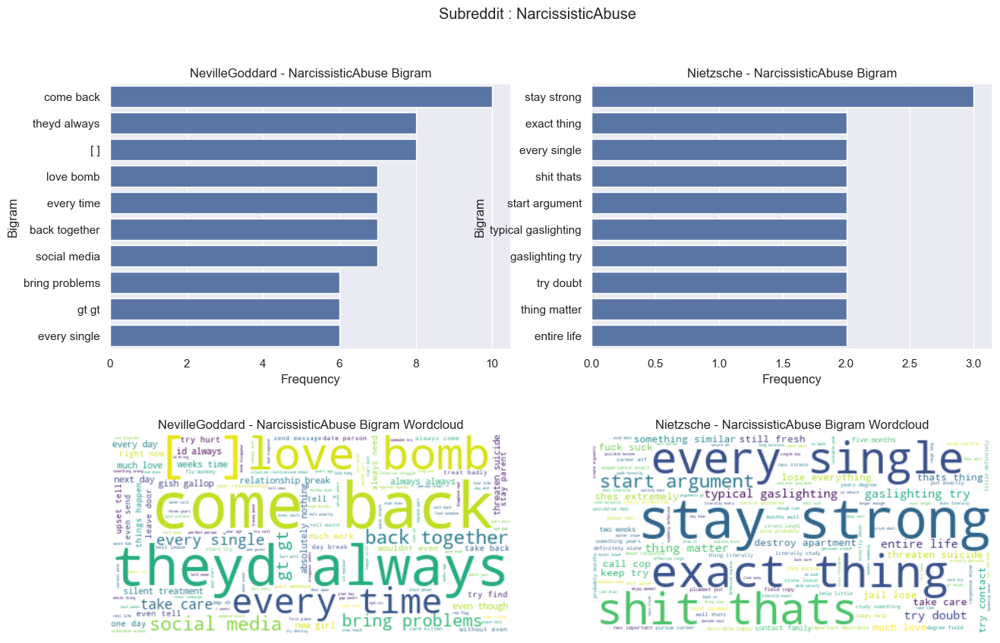

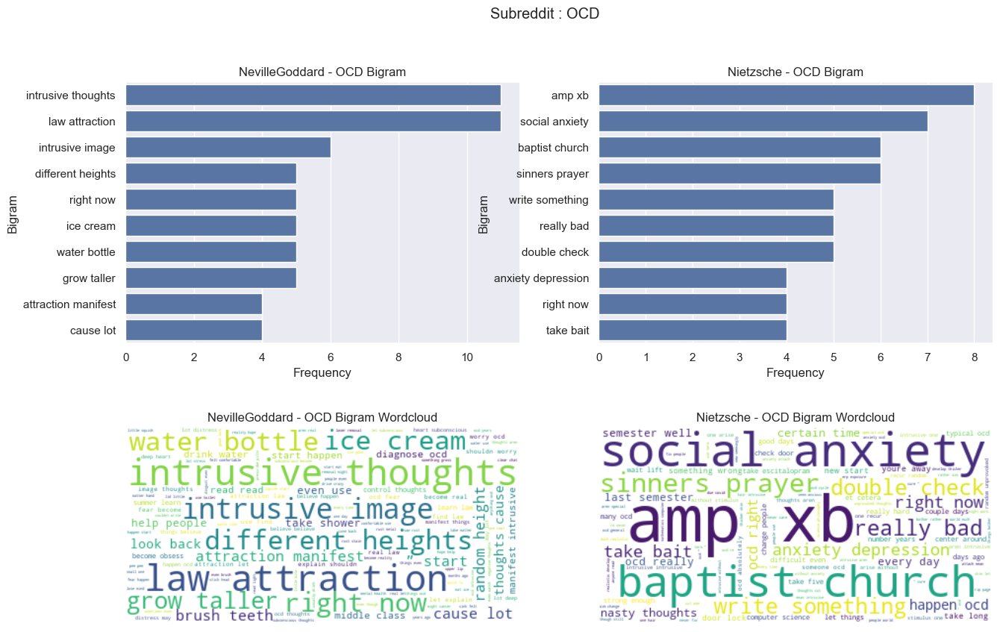

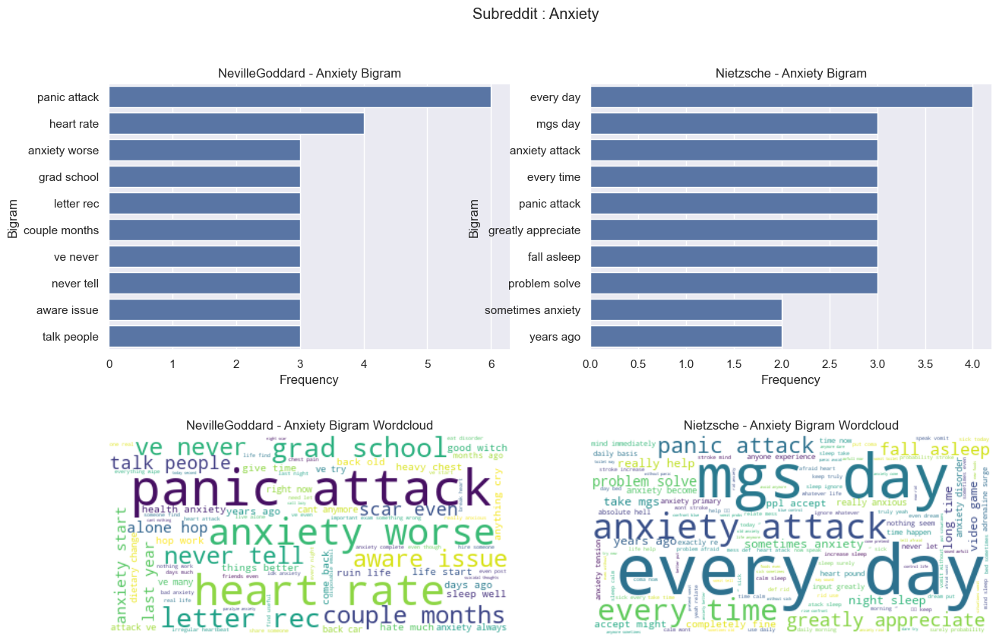

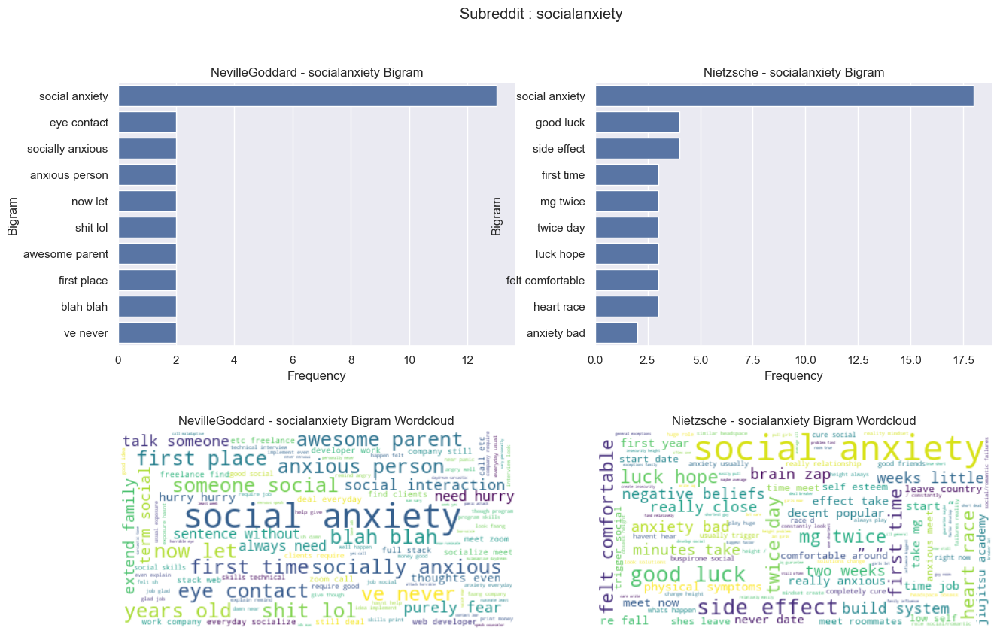

In [10]:
sns.set_color_codes("pastel")
sns.set(rc={'figure.figsize':(15,10)})

for sub in selected_subs:
    bigram_freq_df_1 = n_gram_freq(df_subreddit_1[df_subreddit_1['subreddit']==sub],2)
    bigram_freq_df_2 = n_gram_freq(df_subreddit_2[df_subreddit_2['subreddit']==sub],2)
    
    fig, axs = plt.subplots(nrows= 2, ncols=2)
    fig.suptitle(f'Subreddit : {sub}')
    
    axs[0,0].set_title(f"{subreddit_1} - {sub} Bigram")
    sns.barplot(x="Frequency", y="Bigram", data=bigram_freq_df_1.head(10), color="b", ax= axs[0,0])
    
    axs[0,1].set_title(f"{subreddit_2} - {sub} Bigram")
    sns.barplot(x="Frequency", y="Bigram", data=bigram_freq_df_2.head(10), color="b", ax = axs[0,1])
    
    plt.subplot(2,2,3)
    plot_wordcloud(bigram_freq_df_1, f"{subreddit_1} - {sub} Bigram")
    
    plt.subplot(2,2,4)
    plot_wordcloud(bigram_freq_df_2, f"{subreddit_2} - {sub} Bigram")

## LDA

In [ ]:
#TBD

## Polarity

In [11]:
df_subreddit_1['Polarity'] = df_subreddit_1['processed'].apply(lambda post: TextBlob(str(post)).sentiment[0])
df_subreddit_2['Polarity'] = df_subreddit_2['processed'].apply(lambda post: TextBlob(str(post)).sentiment[1])

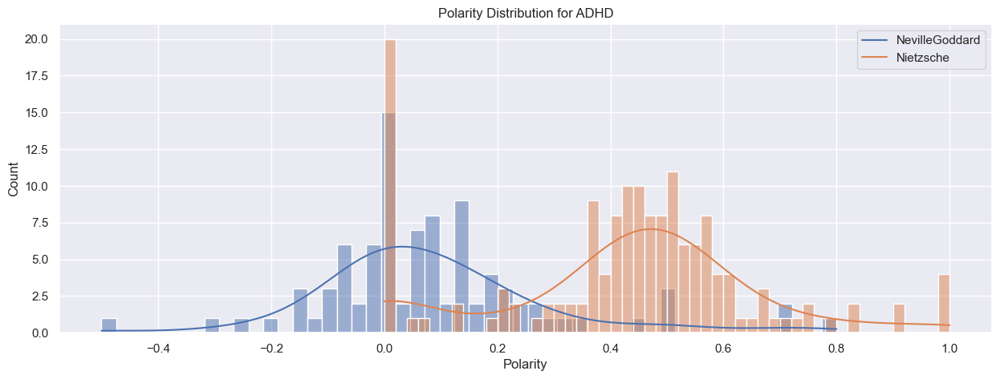

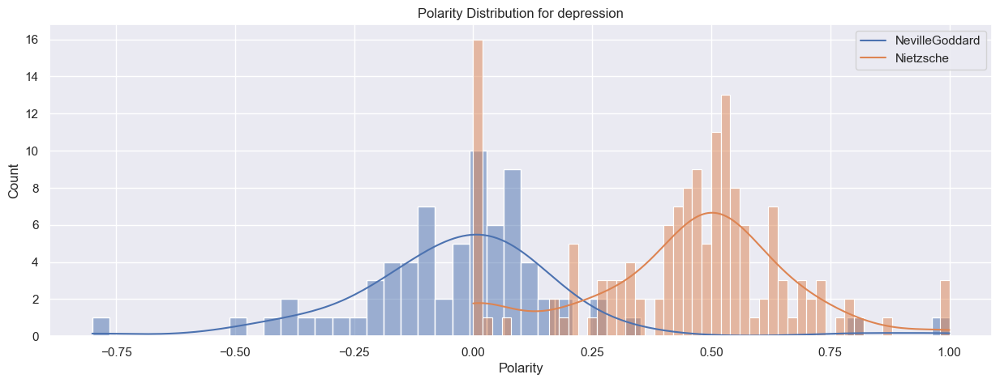

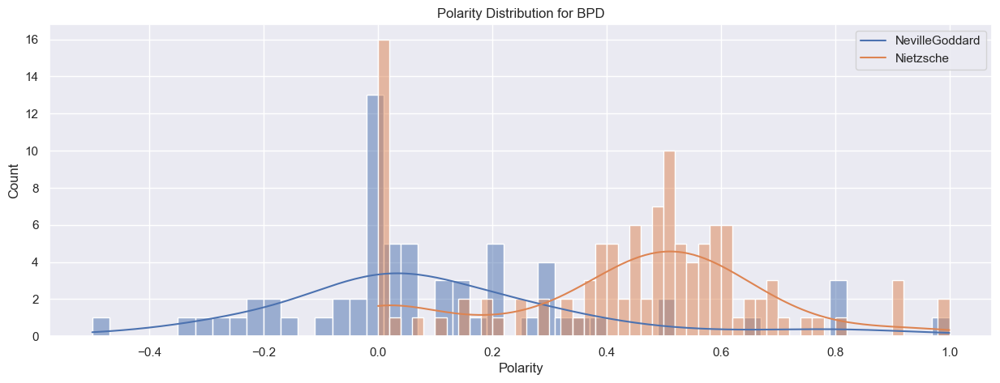

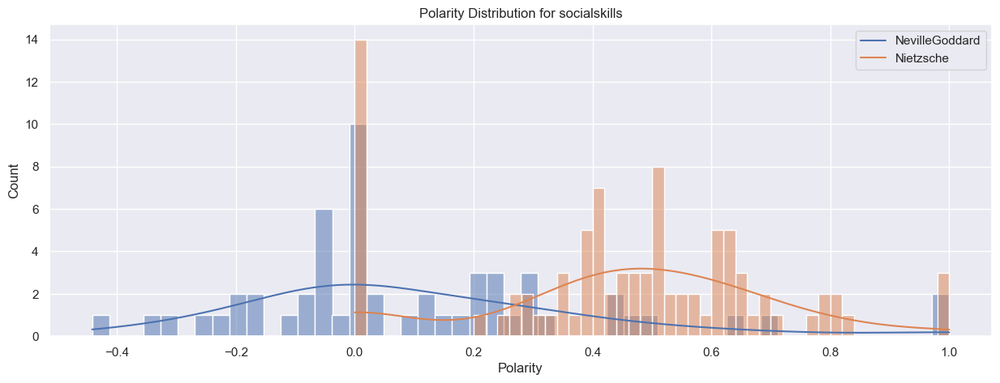

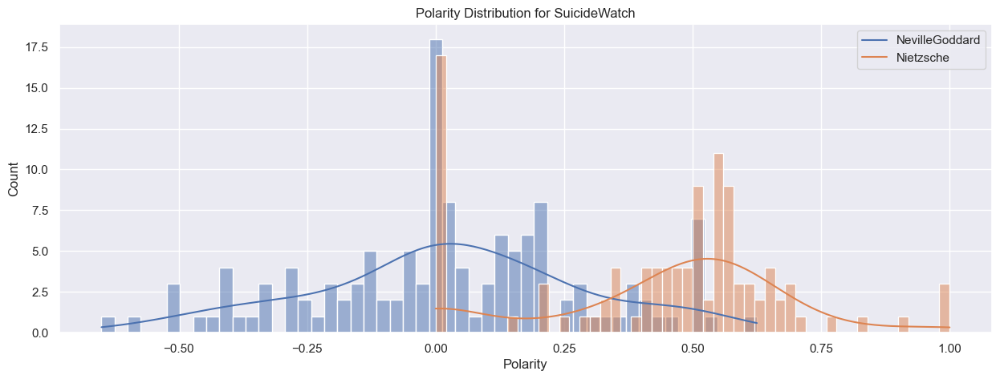

...

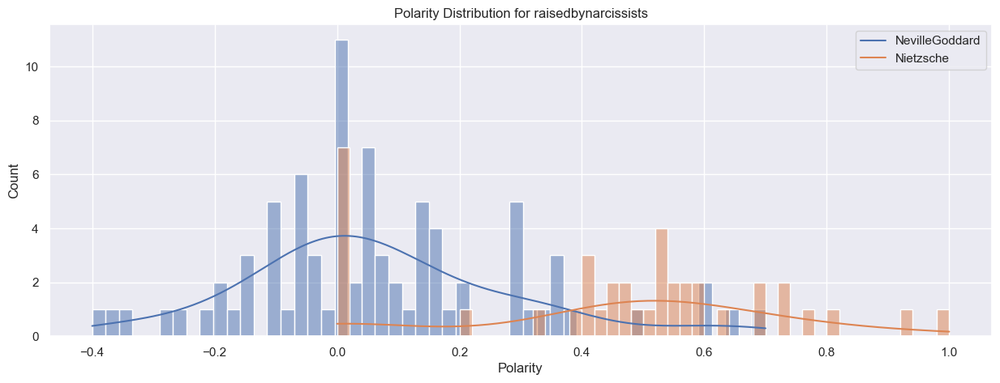

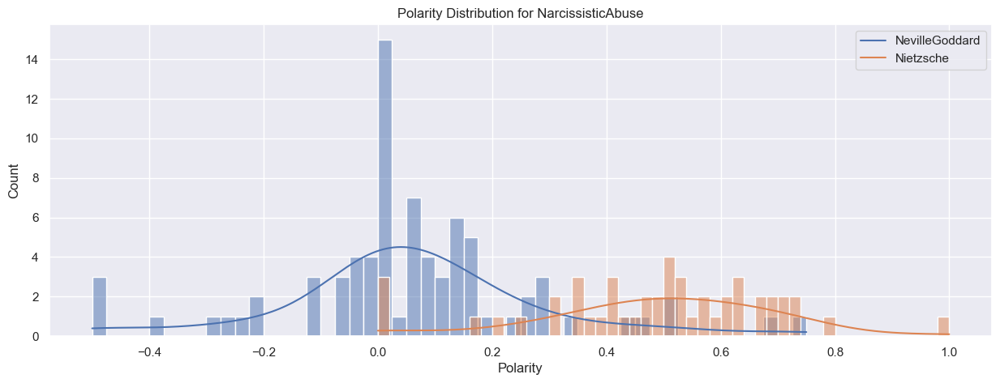

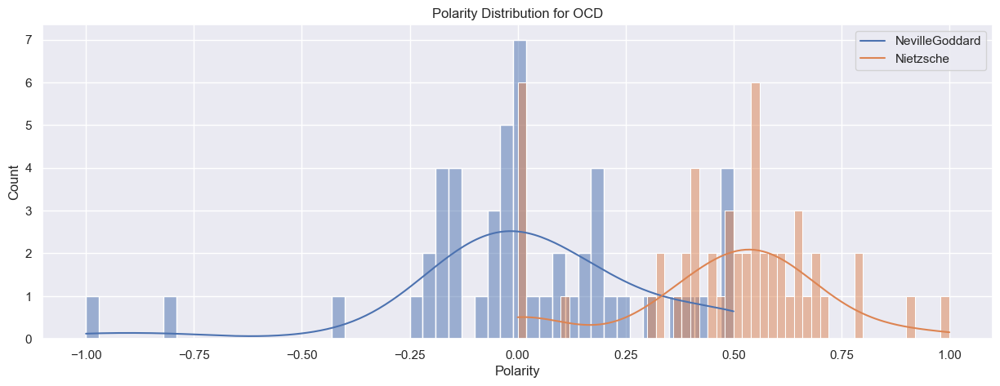

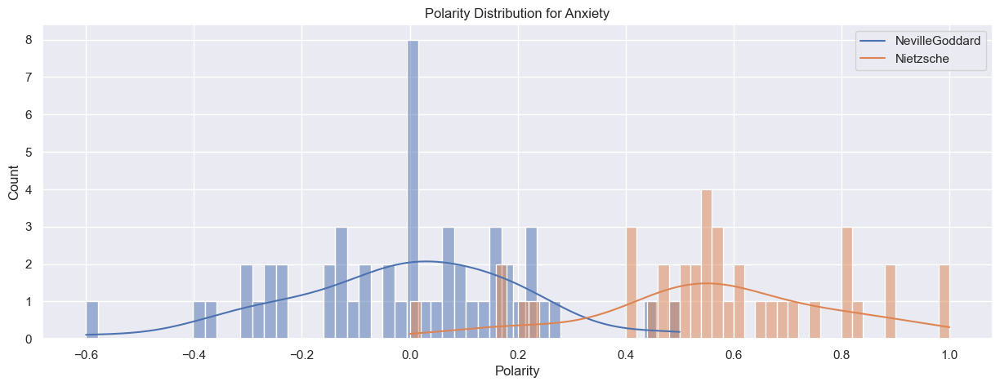

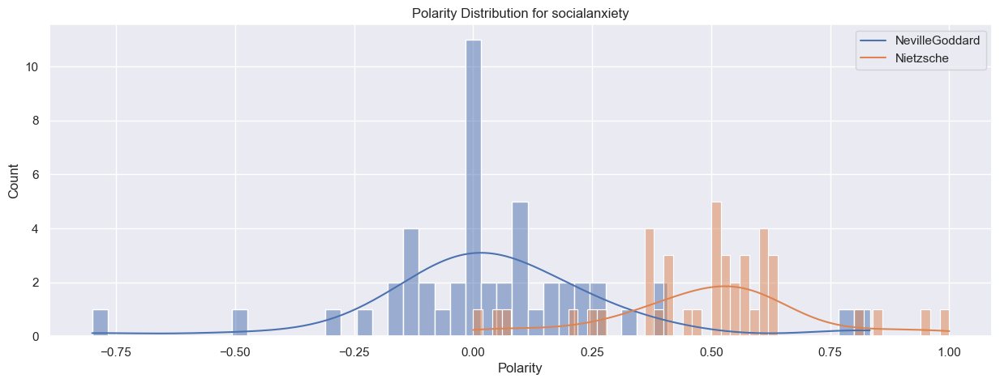

In [12]:
sns.set_color_codes("pastel")
sns.set(rc={'figure.figsize':(15,10)})

for sub in selected_subs:
    polarity_1 = df_subreddit_1[df_subreddit_1['subreddit']==sub]
    polarity_2 = df_subreddit_2[df_subreddit_2['subreddit']==sub]
    
    fig = plt.figure(figsize=(15,5))
    ax = fig.add_subplot(111)
    ax.set_title(f"Polarity Distribution for {sub}")
    
    sns.histplot(polarity_1.Polarity, kde=True, ax = ax, bins = 50)
    sns.histplot(polarity_2.Polarity, kde=True, ax = ax, bins = 50)
    ax.legend([f"{subreddit_1}", f"{subreddit_2}"])
    plt.show()

## Subjectivity

In [13]:
df_subreddit_1['Subjectivity'] = df_subreddit_1['processed'].apply(lambda post: TextBlob(str(post)).sentiment[0])
df_subreddit_2['Subjectivity'] = df_subreddit_2['processed'].apply(lambda post: TextBlob(str(post)).sentiment[1])

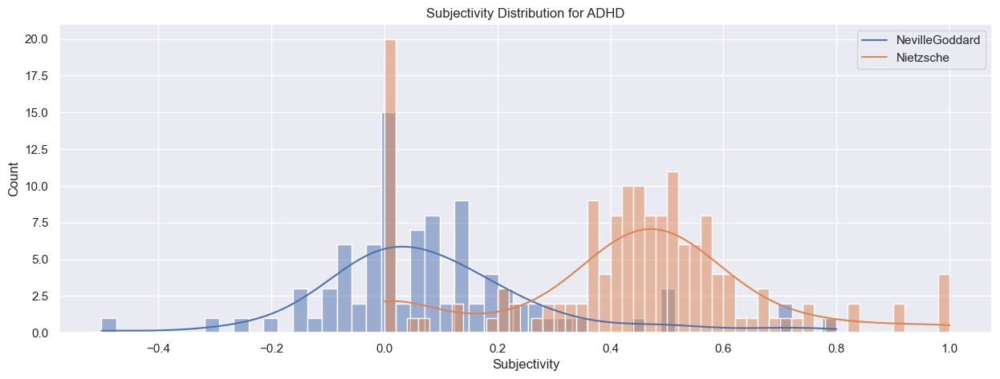

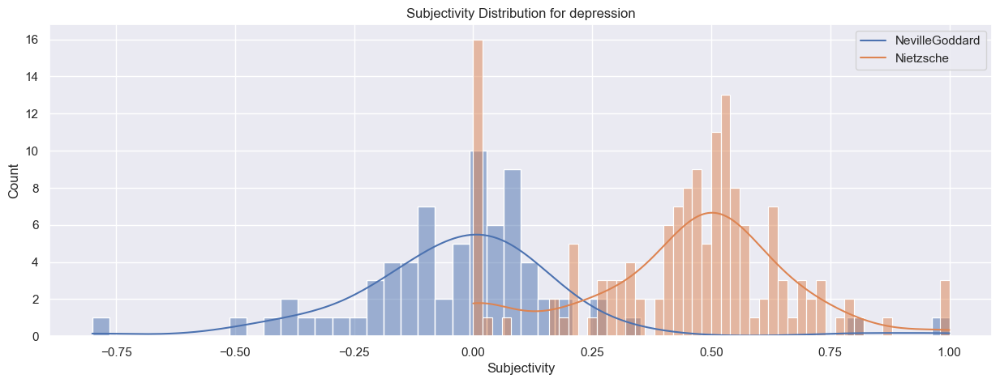

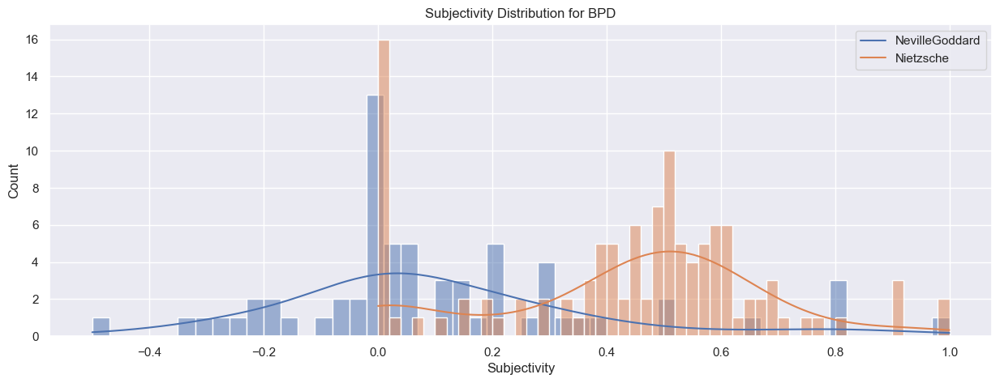

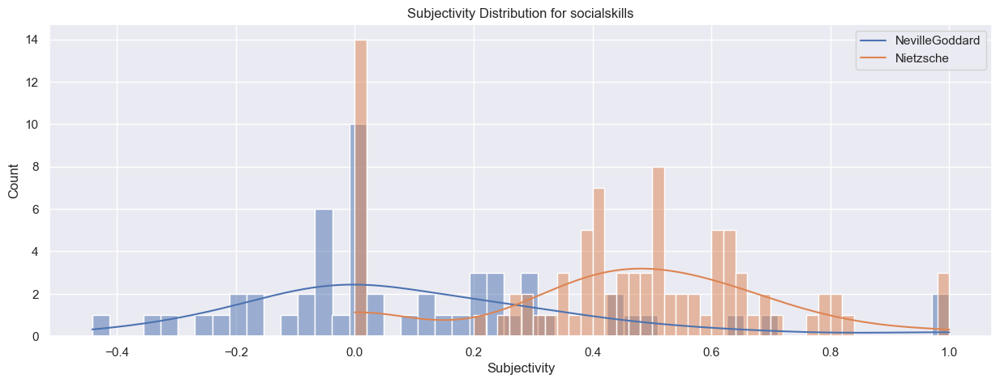

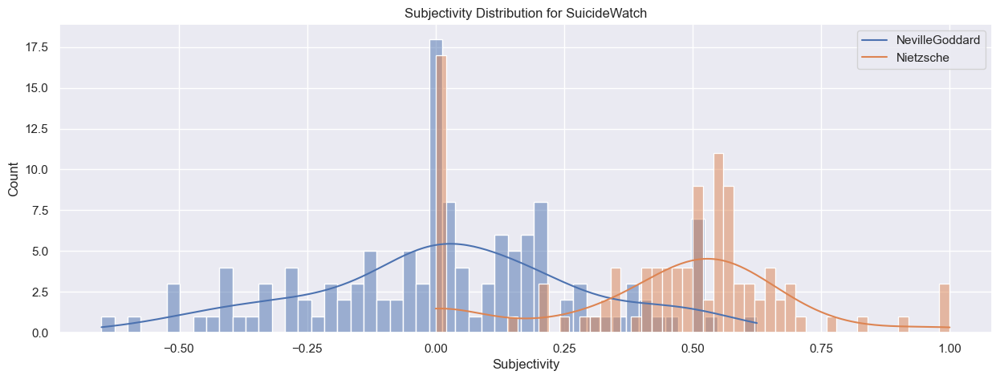

...

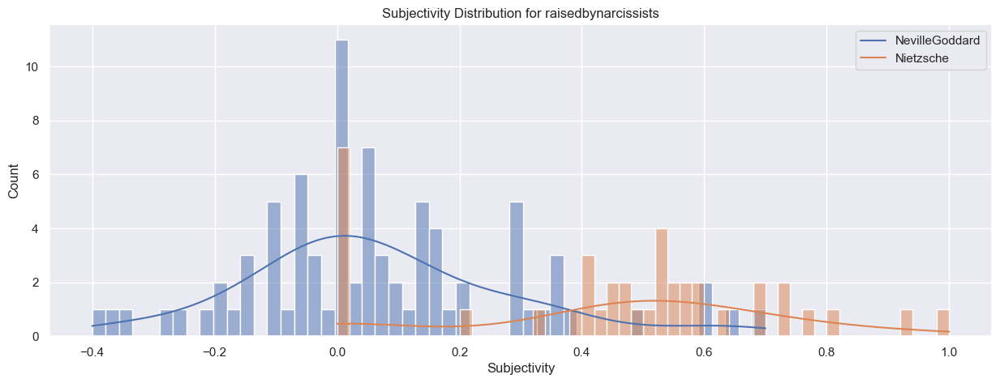

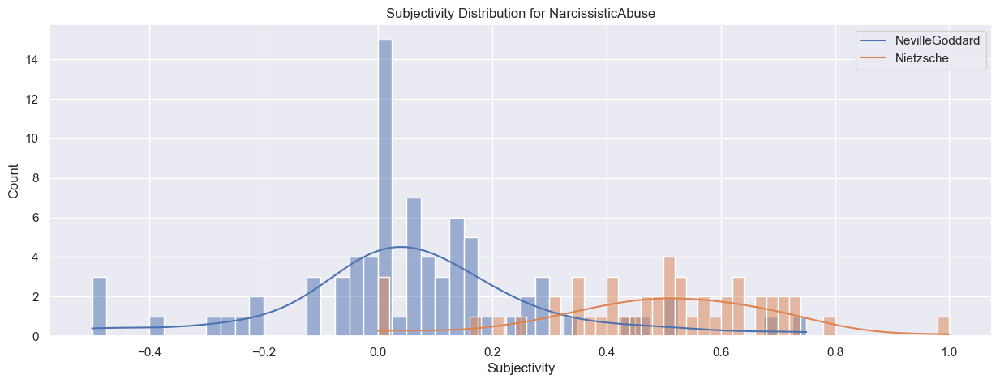

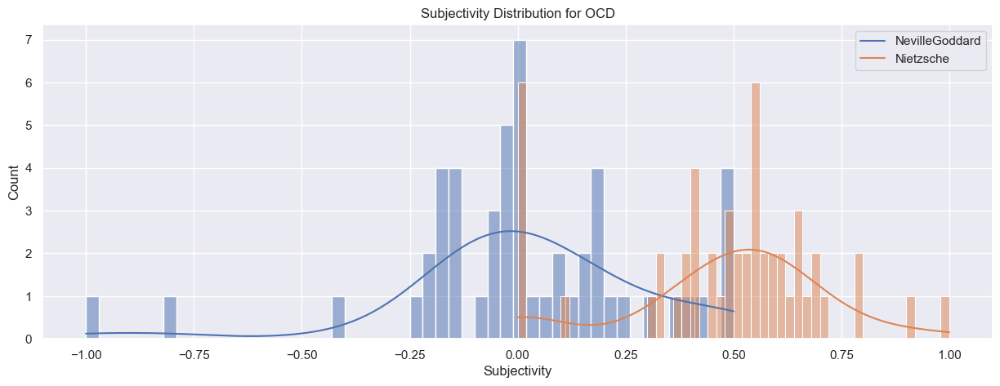

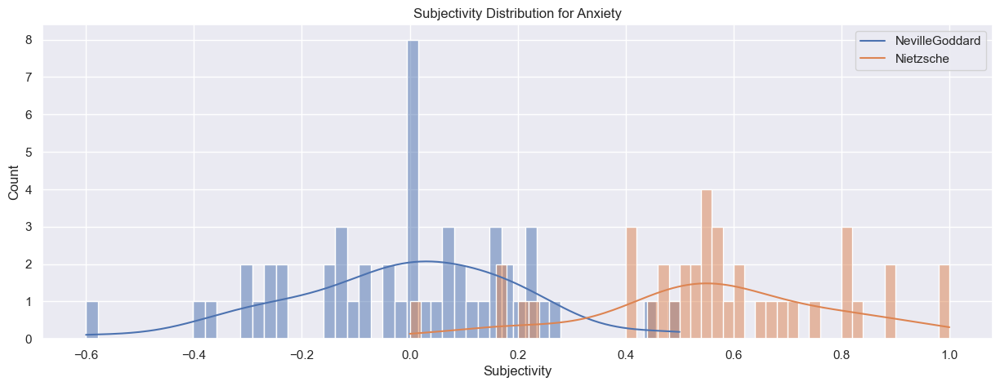

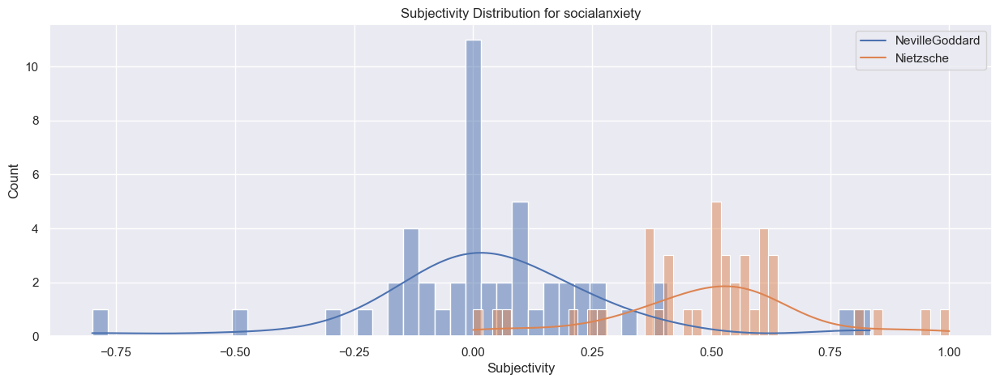

In [14]:
sns.set_color_codes("pastel")
sns.set(rc={'figure.figsize':(15,10)})

for sub in selected_subs:
    subjectivity_1 = df_subreddit_1[df_subreddit_1['subreddit']==sub]
    subjectivity_2 = df_subreddit_2[df_subreddit_2['subreddit']==sub]
    
    fig = plt.figure(figsize=(15,5))
    ax = fig.add_subplot(111)
    ax.set_title(f"Subjectivity Distribution for {sub}")
    
    sns.histplot(subjectivity_1.Subjectivity, kde=True, ax = ax, bins = 50)
    sns.histplot(subjectivity_2.Subjectivity, kde=True, ax = ax, bins = 50)
    ax.legend([f"{subreddit_1}", f"{subreddit_2}"])
    plt.show()

## Empath Scores

In [15]:
df_subreddit_1 = get_empath_data(df_subreddit_1)
df_subreddit_2 = get_empath_data(df_subreddit_2)

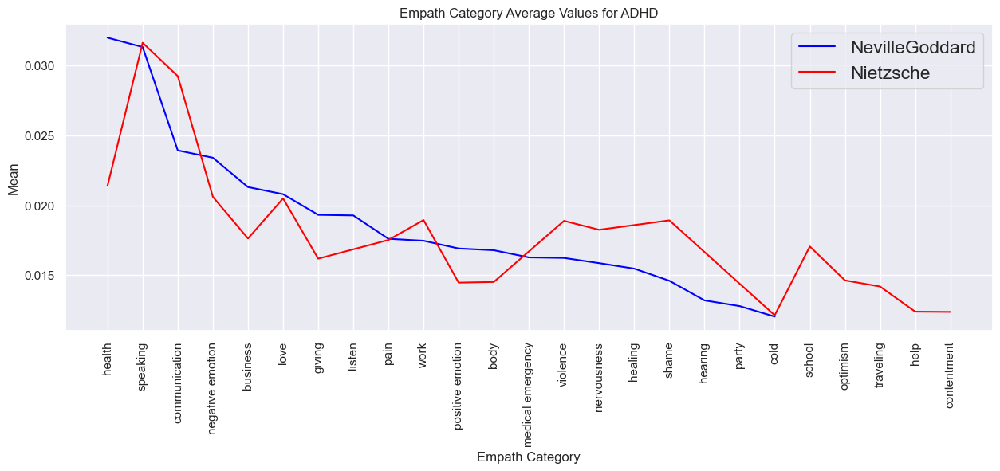

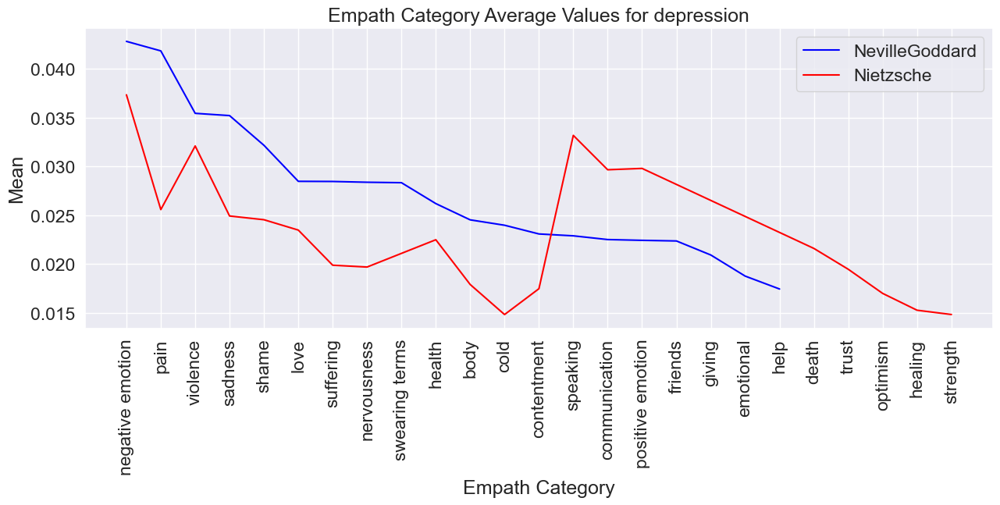

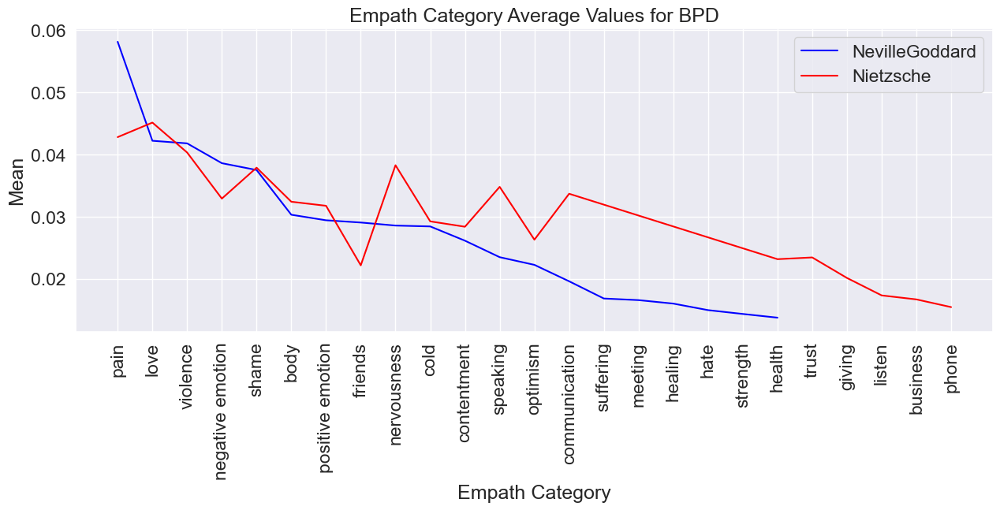

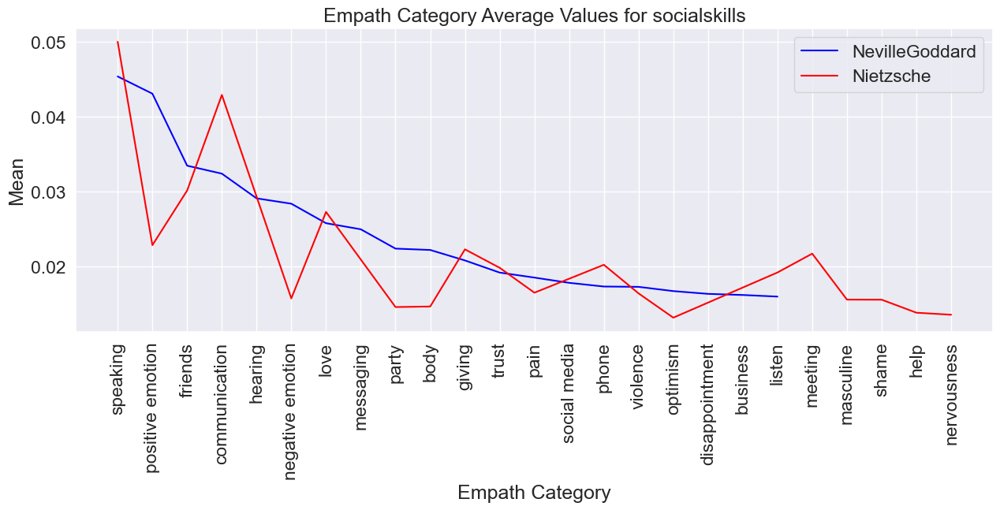

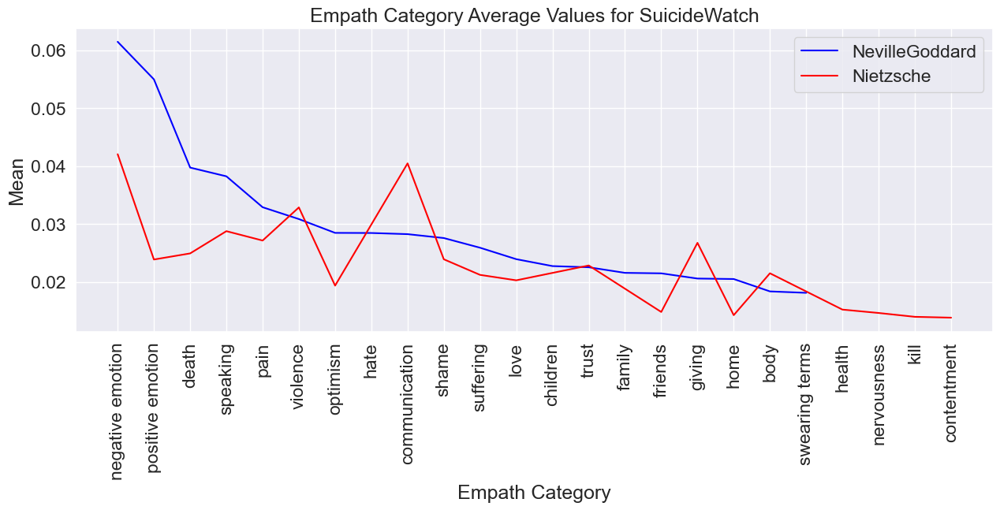

...

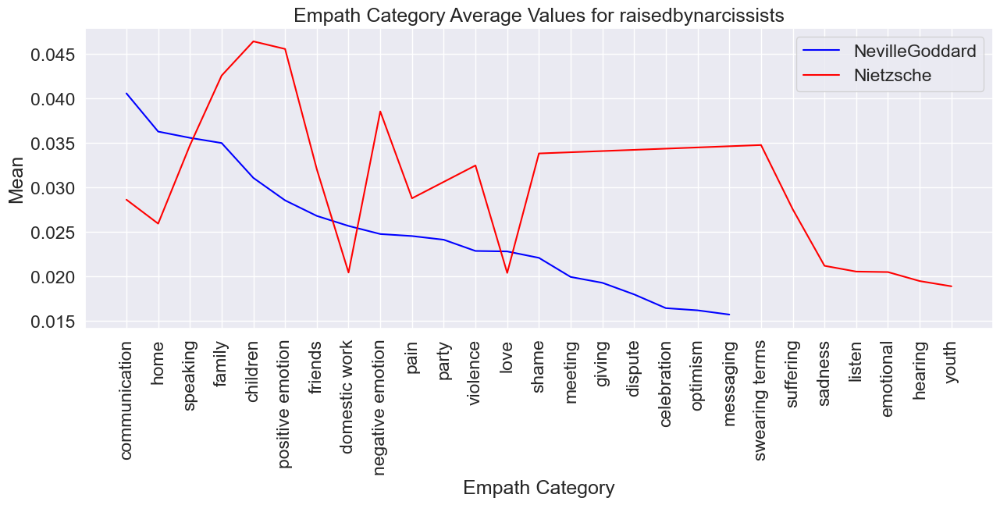

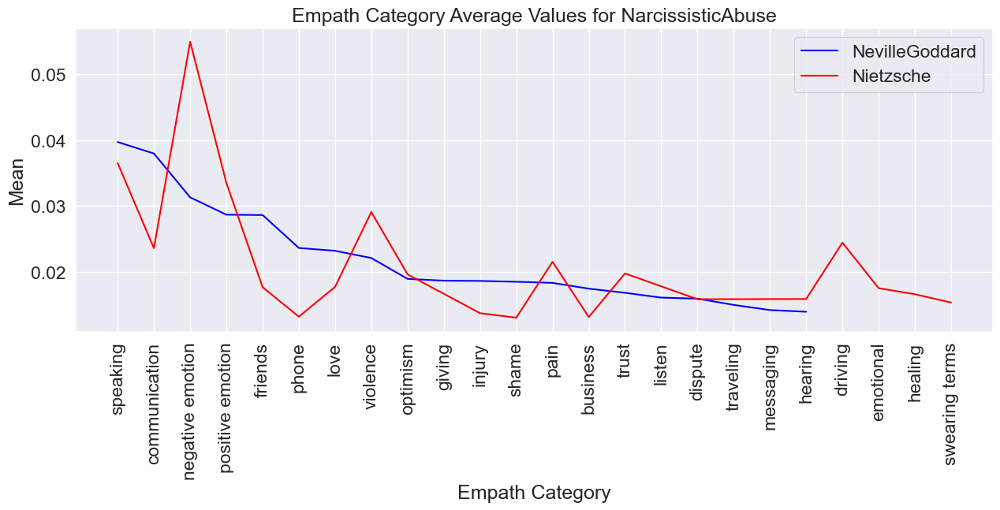

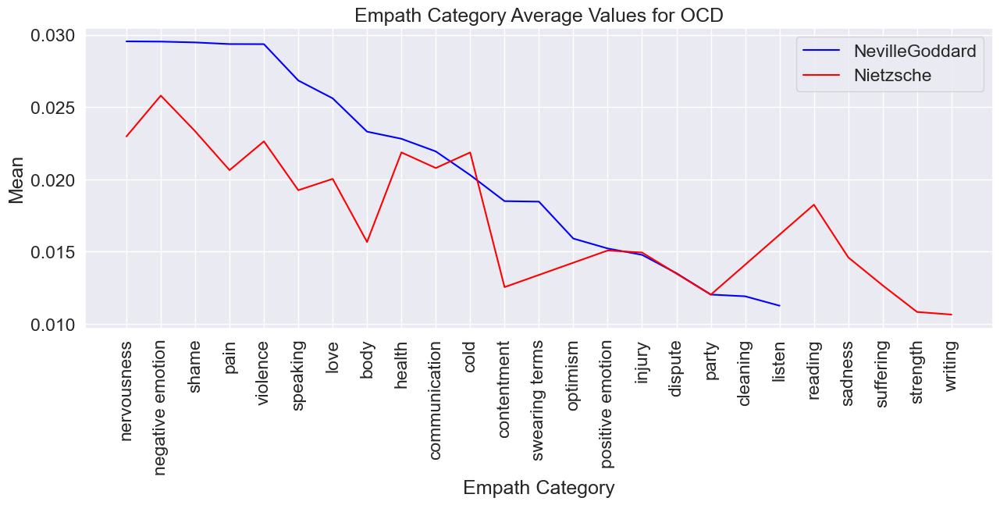

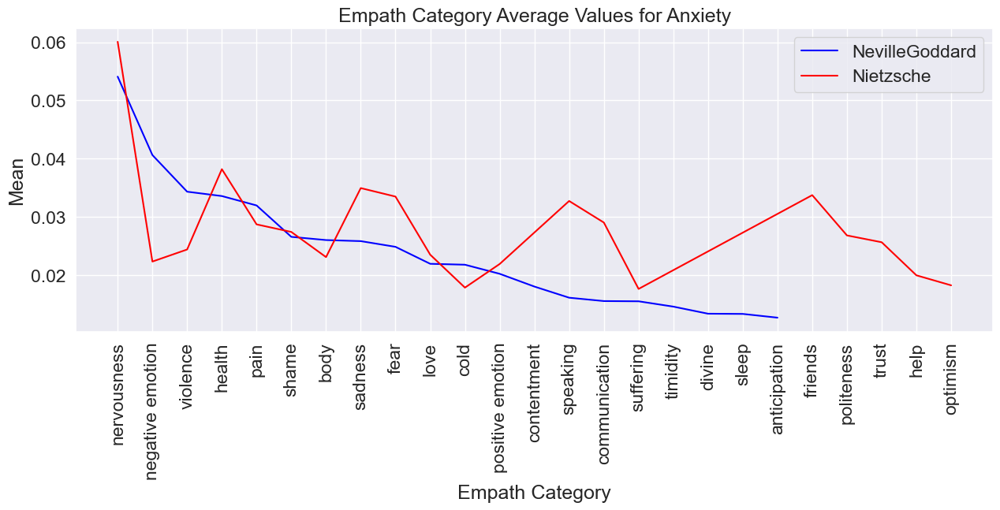

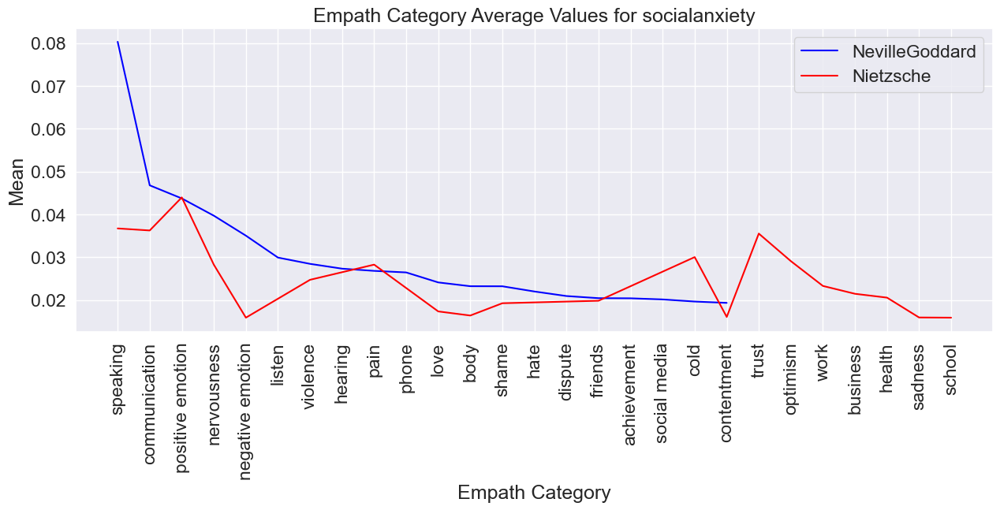

In [16]:
empath_cols = [col for col in df_subreddit_1.columns if col.startswith('emp')]

for sub in selected_subs:
    mean_df_1 = df_subreddit_1[df_subreddit_1['subreddit']==sub].\
                loc[:,empath_cols].\
                mean(axis=0).sort_values(ascending = False).\
                reset_index()
    
    mean_df_1.columns = ["Empath Category", "Mean"]
    mean_df_1["Empath Category"] = mean_df_1["Empath Category"].apply(lambda x: " ".join(x.split("_")[1:]) )
    mean_df_1 = mean_df_1.head(20)

    
    mean_df_2 = df_subreddit_2[df_subreddit_2['subreddit']==sub].\
                loc[:,empath_cols].\
                mean(axis=0).sort_values(ascending = False).\
                reset_index()
    
    mean_df_2.columns = ["Empath Category", "Mean"]
    mean_df_2["Empath Category"] = mean_df_2["Empath Category"].apply(lambda x: " ".join(x.split("_")[1:]) )
    mean_df_2 = mean_df_2.head(20)
    
    fig = plt.figure(figsize=(15,5))
    ax = fig.add_subplot(111)
    ax.set_title(f"Empath Category Average Values for {sub}")
    sns.lineplot(data = mean_df_1, x = "Empath Category", y= "Mean", ax = ax, label = f"{subreddit_1}", color = 'blue')
    sns.lineplot(data = mean_df_2, x = "Empath Category", y= "Mean", ax = ax, label = f"{subreddit_2}", color = 'red')
    sns.set(font_scale=1.5)
    plt.legend()
    plt.xticks(rotation=90)
    plt.show()

## NRCLex Scores

In [17]:
df_subreddit_1 = get_nrclex_data(df_subreddit_1)
df_subreddit_2 = get_nrclex_data(df_subreddit_2)

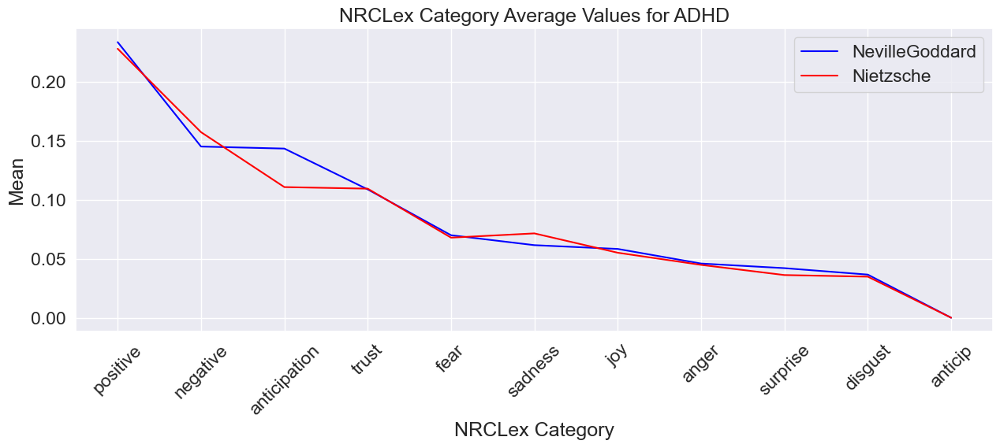

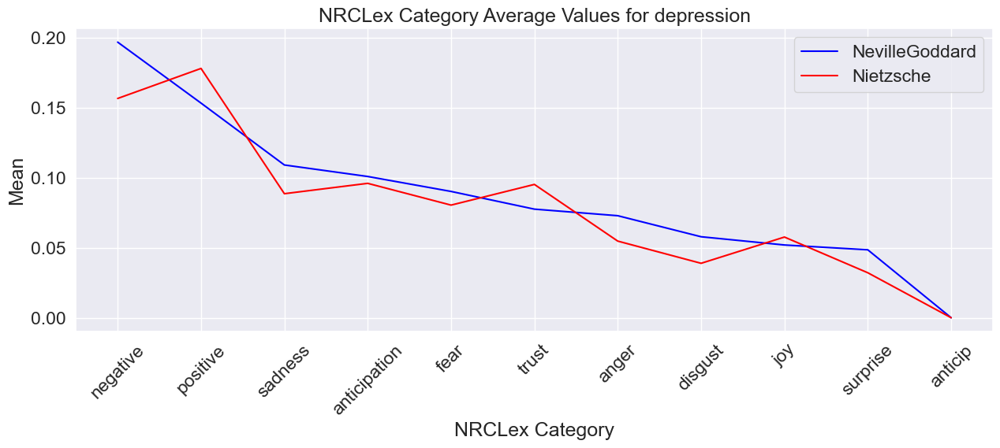

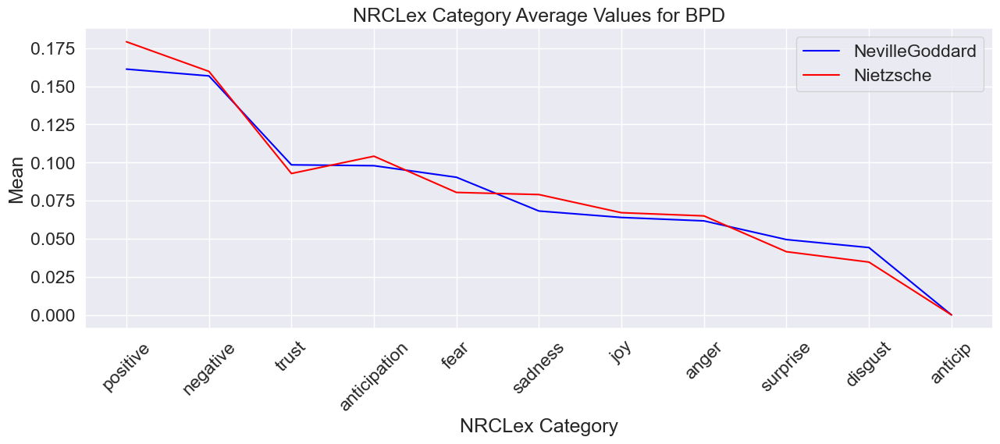

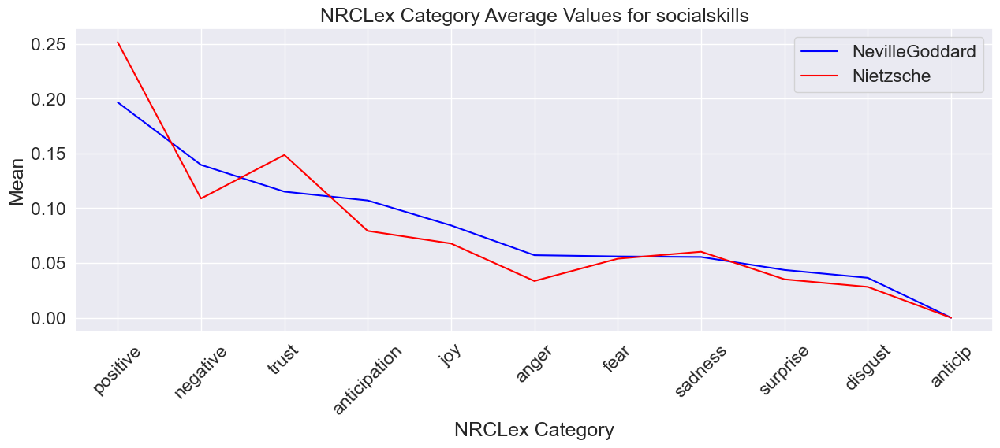

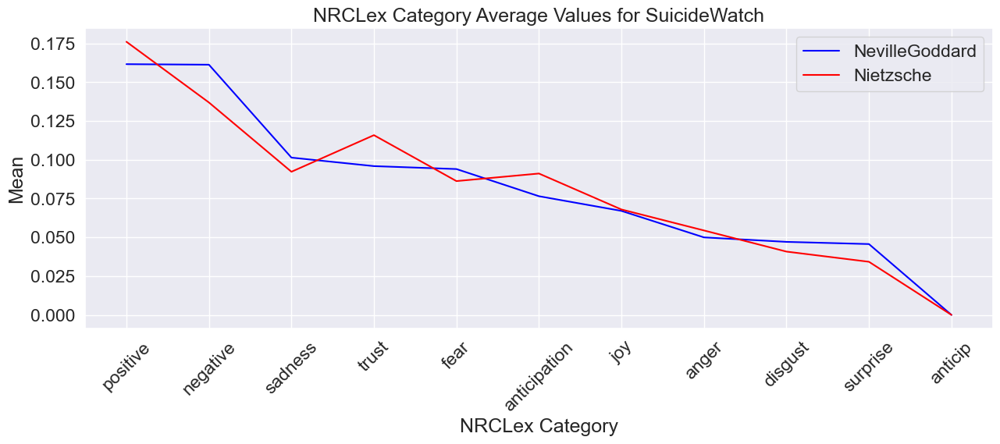

...

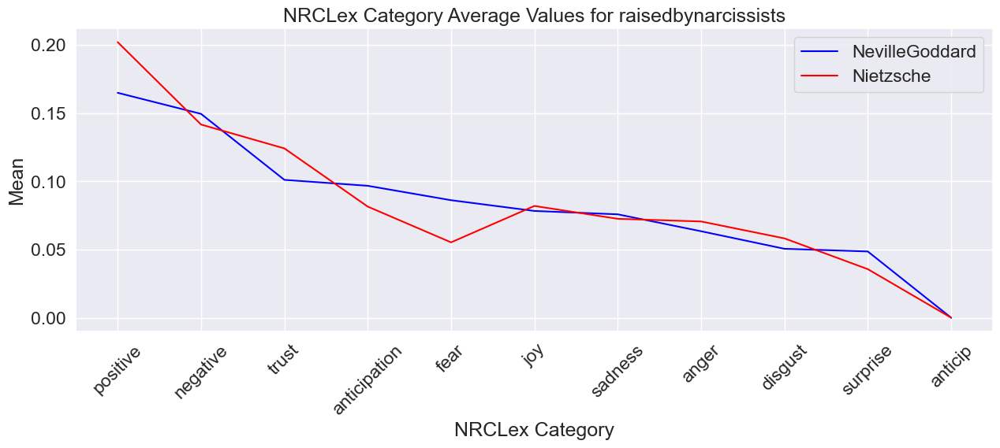

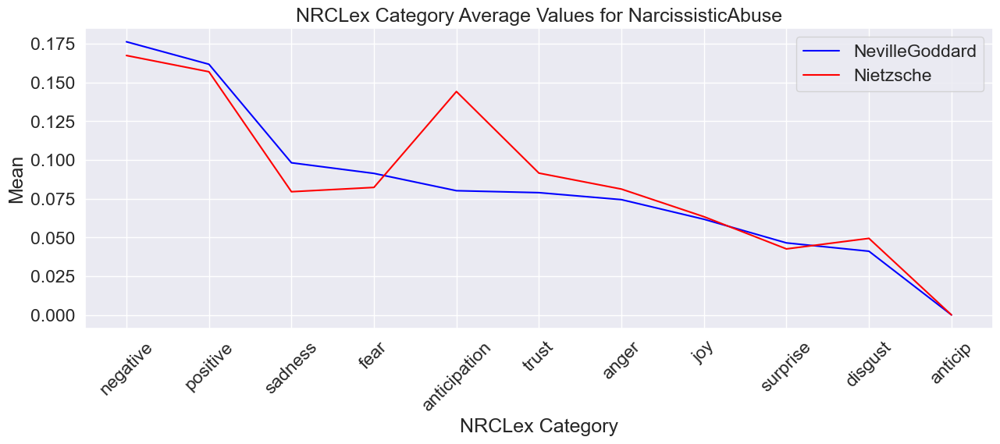

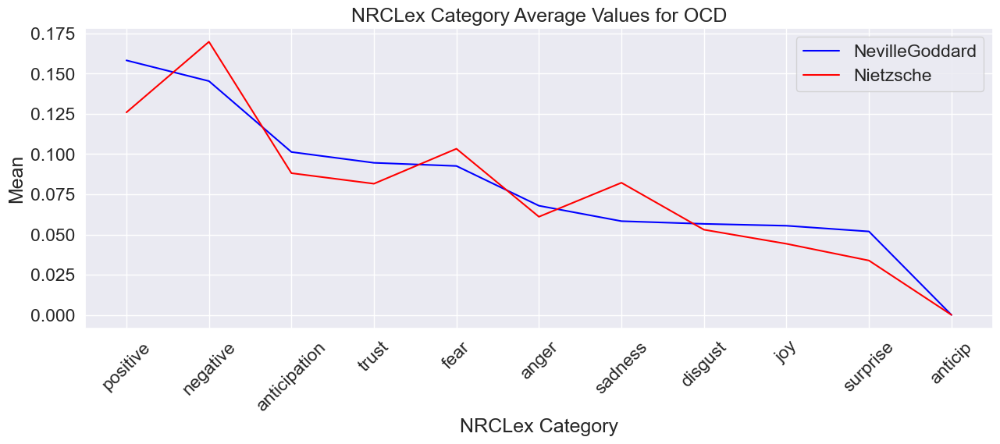

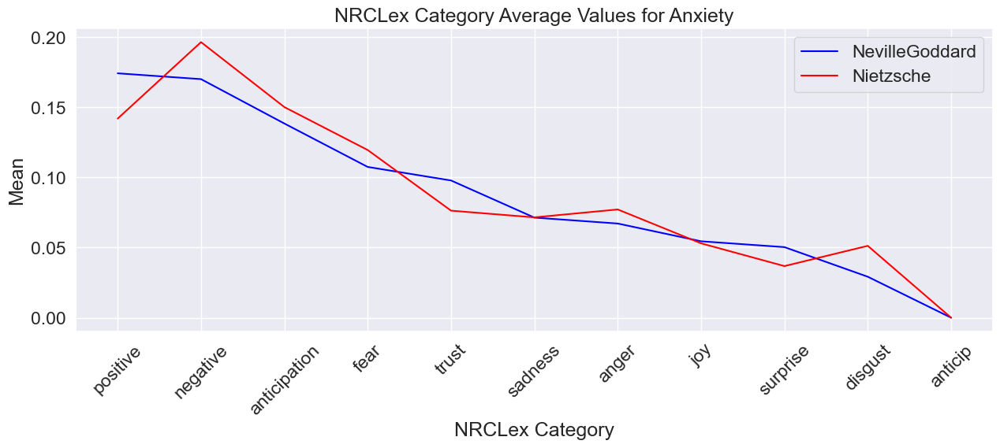

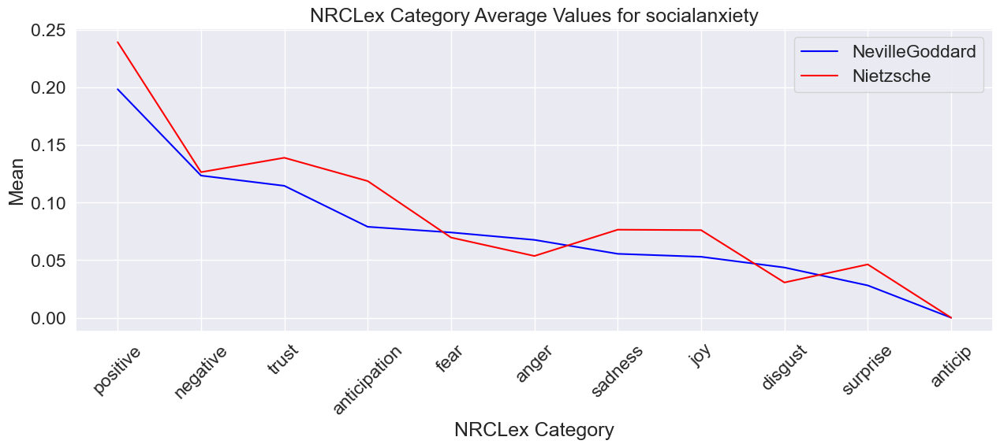

In [18]:
nrc_cols = [col for col in df_subreddit_1.columns if col.startswith('nrc')]

for sub in selected_subs:
    mean_df_1 = df_subreddit_1[df_subreddit_1['subreddit']==sub].\
                loc[:,nrc_cols].\
                mean(axis=0).sort_values(ascending = False).\
                reset_index()
    
    mean_df_1.columns = ["NRCLex Category", "Mean"]
    mean_df_1["NRCLex Category"] = mean_df_1["NRCLex Category"].apply(lambda x: " ".join(x.split("_")[1:]) )
    mean_df_1 = mean_df_1

    
    mean_df_2 = df_subreddit_2[df_subreddit_2['subreddit']==sub].\
                loc[:,nrc_cols].\
                mean(axis=0).sort_values(ascending = False).\
                reset_index()
    
    mean_df_2.columns = ["NRCLex Category", "Mean"]
    mean_df_2["NRCLex Category"] = mean_df_2["NRCLex Category"].apply(lambda x: " ".join(x.split("_")[1:]) )
    mean_df_2 = mean_df_2
    
    fig = plt.figure(figsize=(15,5))
    ax = fig.add_subplot(111)
    ax.set_title(f"NRCLex Category Average Values for {sub}")
    sns.lineplot(data = mean_df_1, x = "NRCLex Category", y= "Mean", ax = ax, label = f"{subreddit_1}", color = 'blue')
    sns.lineplot(data = mean_df_2, x = "NRCLex Category", y= "Mean", ax = ax, label = f"{subreddit_2}", color = 'red')
    sns.set(font_scale=1.5)
    plt.legend()
    plt.xticks(rotation=45)
    plt.show()

## Verb Category Frequency

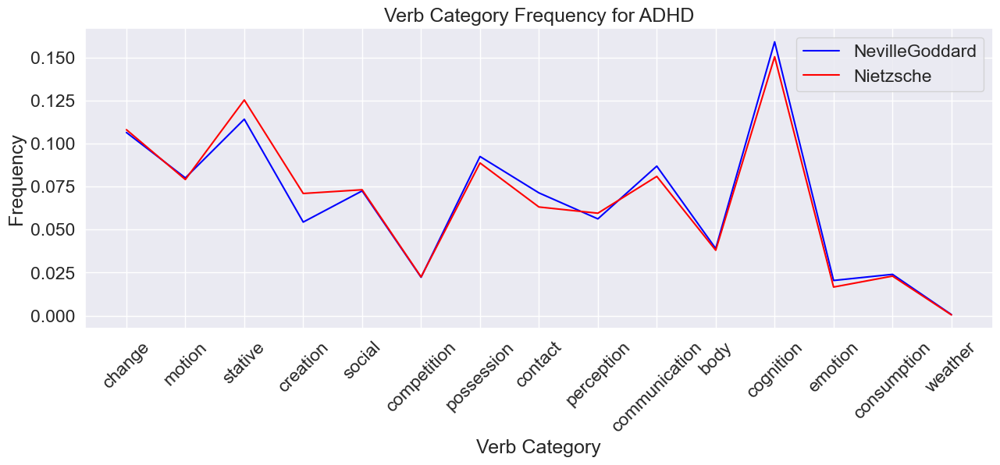

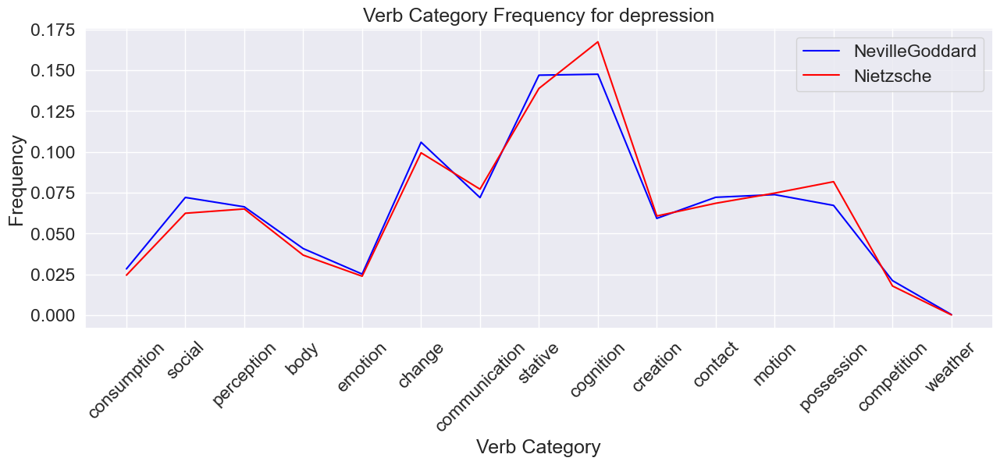

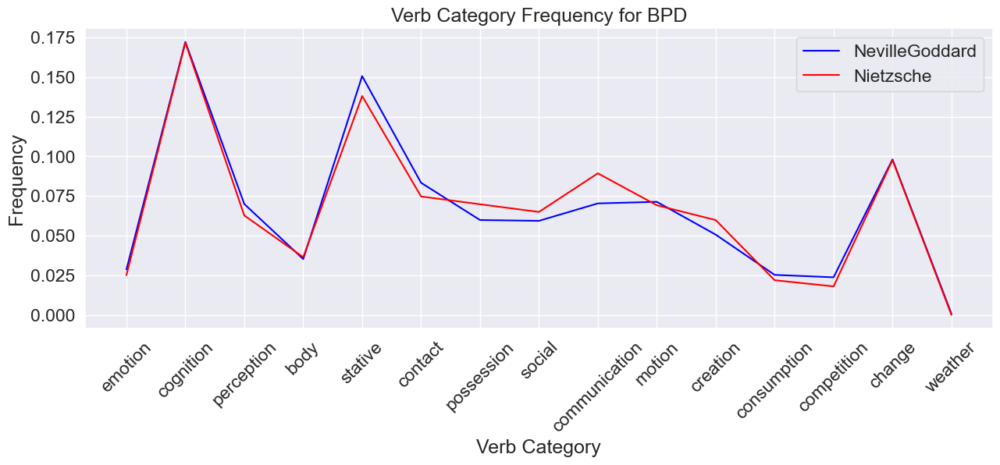

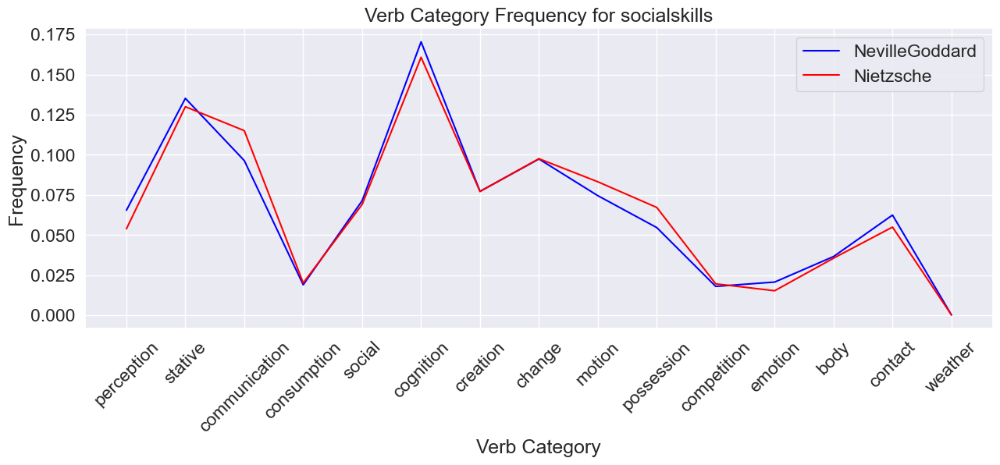

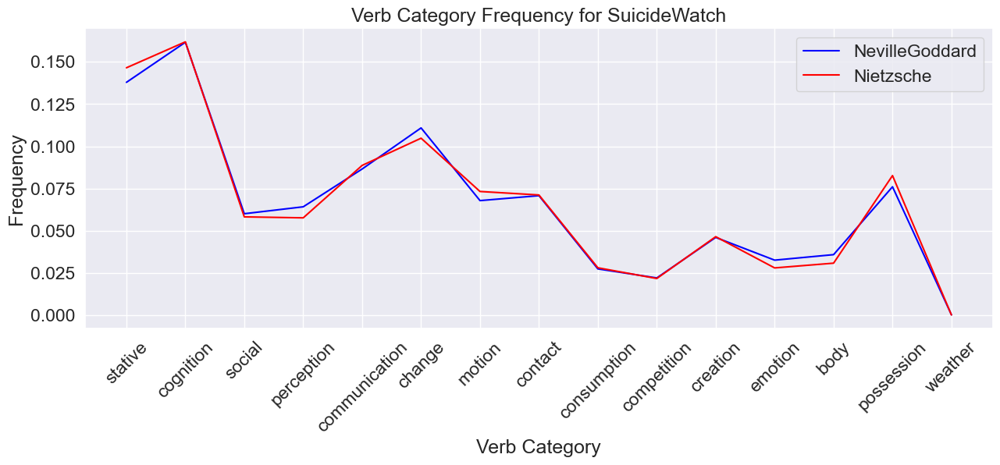

...

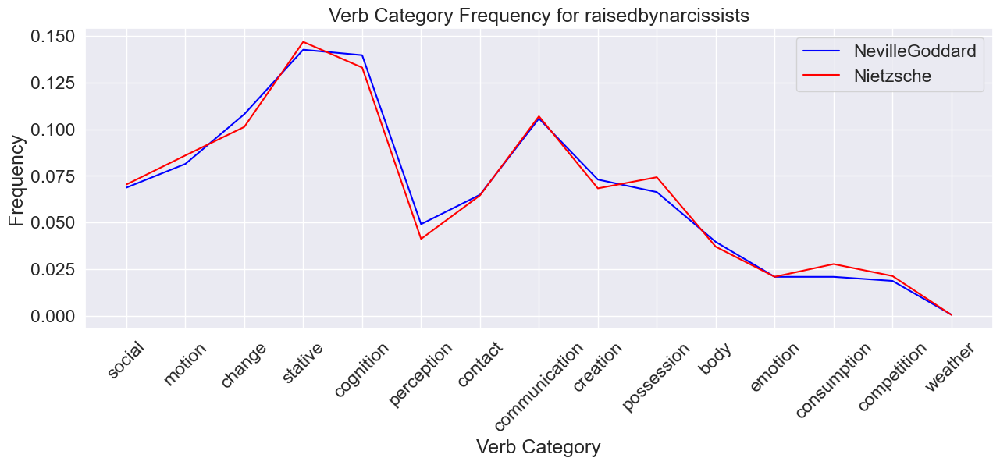

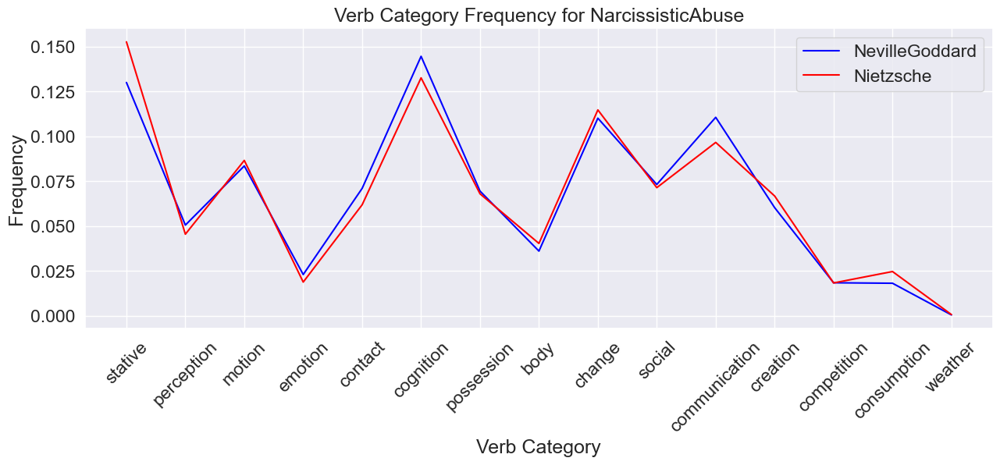

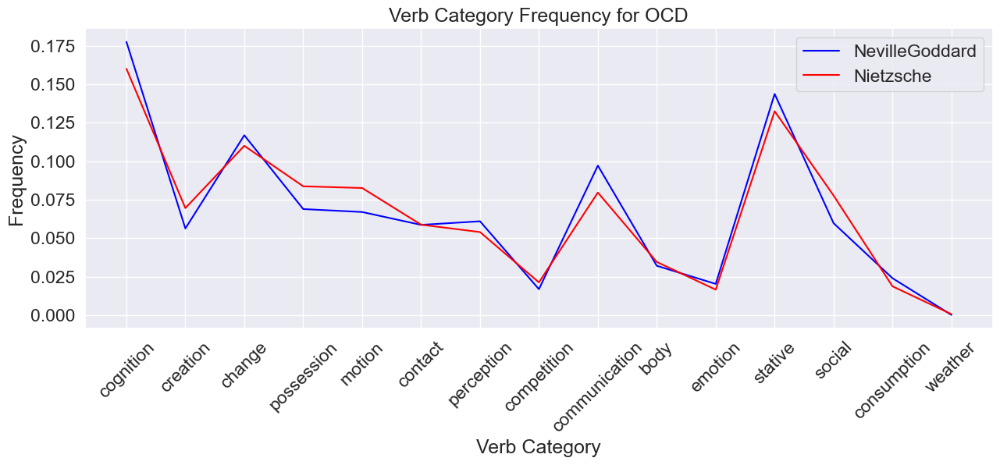

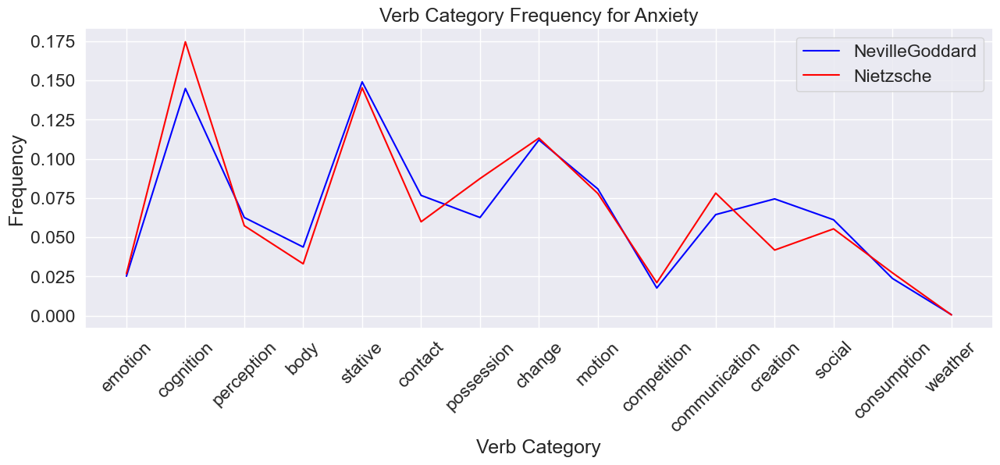

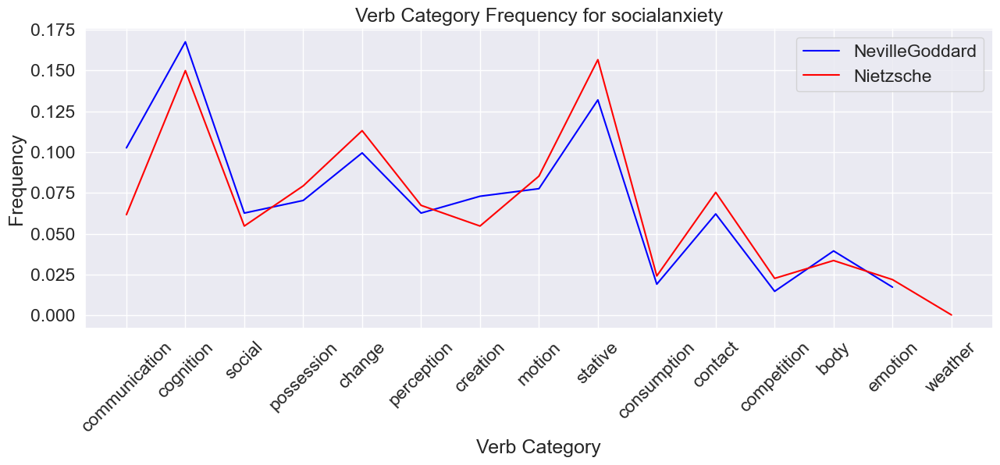

In [19]:
for sub in selected_subs:
    
    verb_df_1 = verb_count(df_subreddit_1[df_subreddit_1["subreddit"] == sub]) 
    verb_df_1["Frequency"] = verb_df_1["Count"]/verb_df_1["Count"].sum()
    
    verb_df_2 = verb_count(df_subreddit_2[df_subreddit_2["subreddit"] == sub])
    verb_df_2["Frequency"] = verb_df_2["Count"]/verb_df_2["Count"].sum()
    
    fig = plt.figure(figsize=(15,5))
    ax = fig.add_subplot(111)
    ax.set_title(f"Verb Category Frequency for {sub}")
    sns.lineplot(data = verb_df_1, x = "Verb Category", y= 'Frequency', ax = ax, label = f"{subreddit_1}", color = 'blue')
    sns.lineplot(data = verb_df_2, x = "Verb Category", y= 'Frequency', ax = ax, label = f"{subreddit_2}", color = 'red')
    sns.set(font_scale=1.5)
    plt.legend()
    plt.xticks(rotation=45)
    plt.show()

## Noun Category Frequency

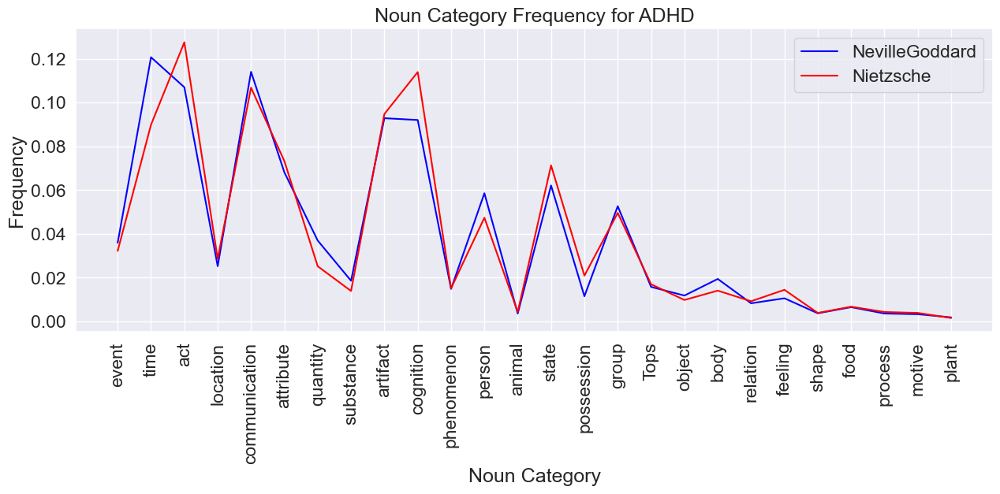

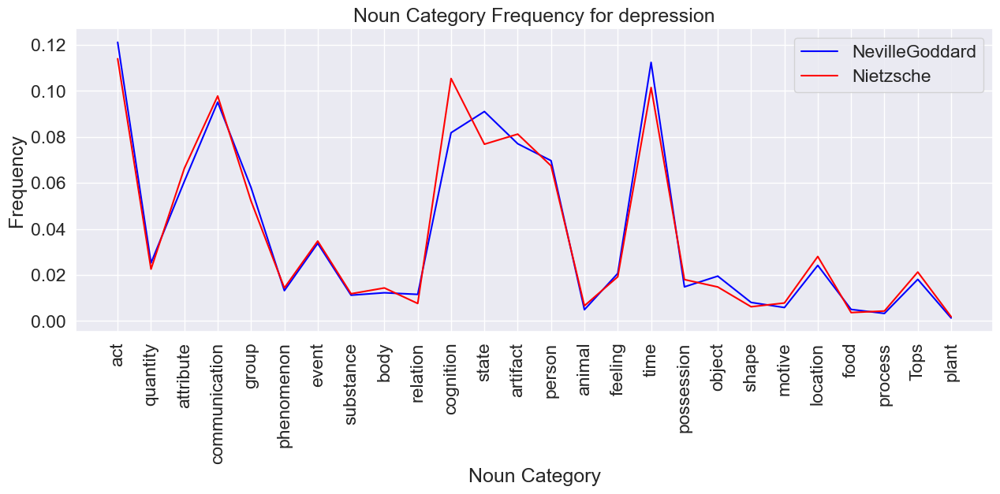

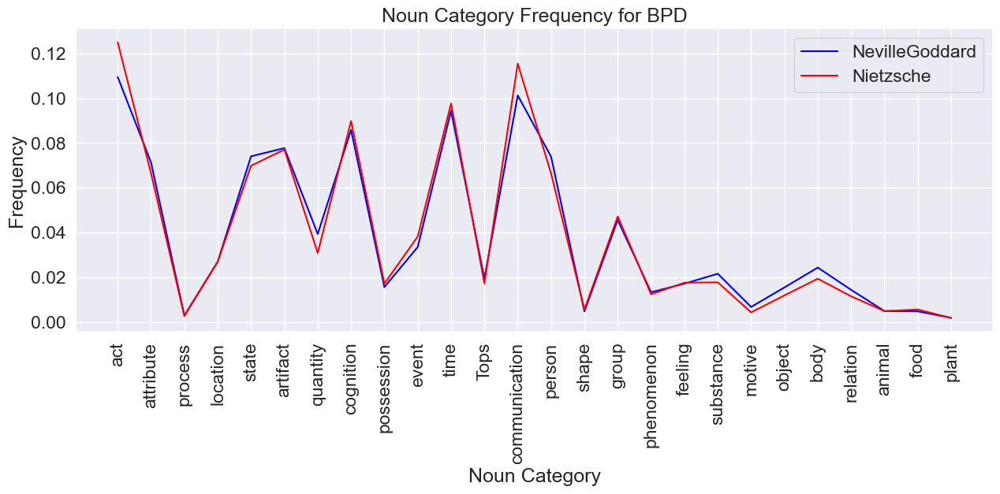

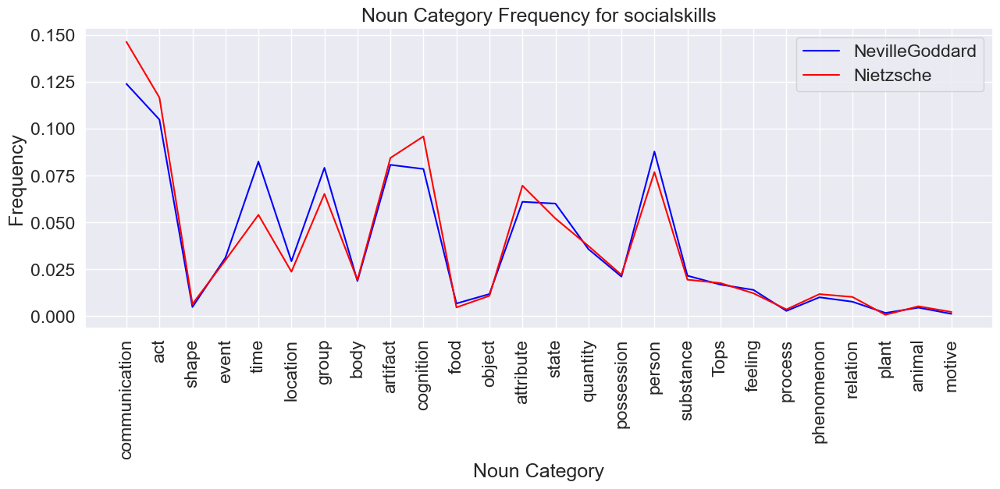

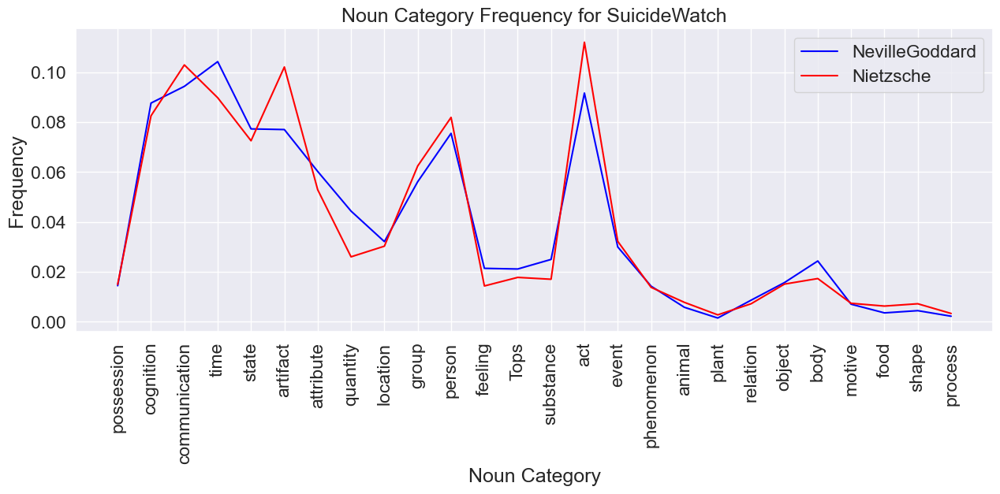

...

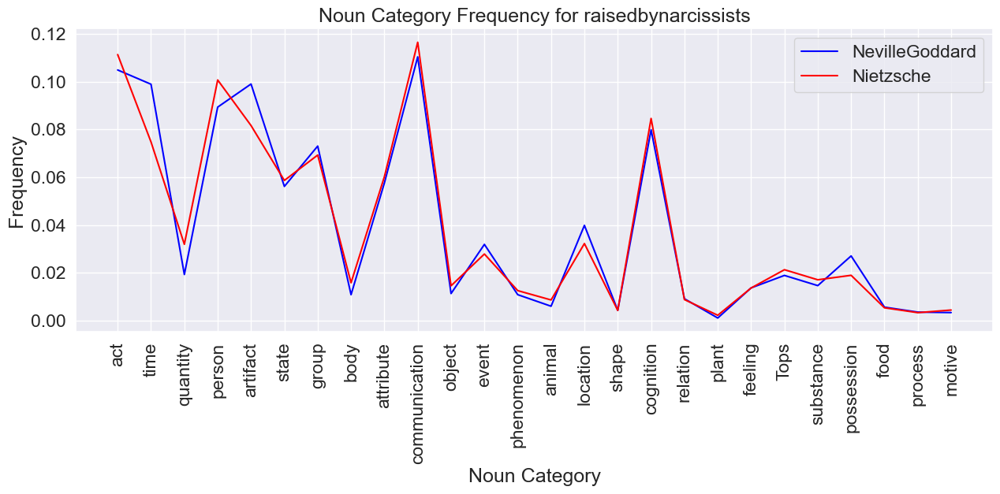

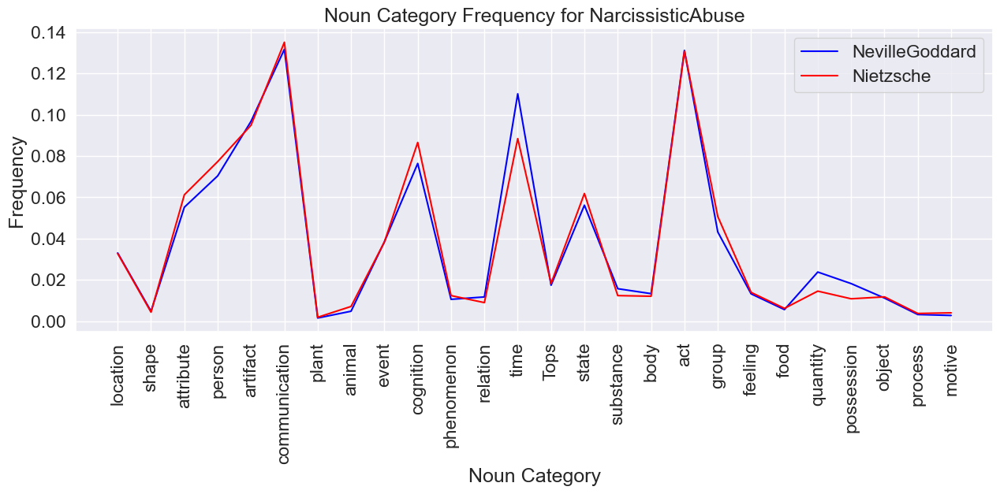

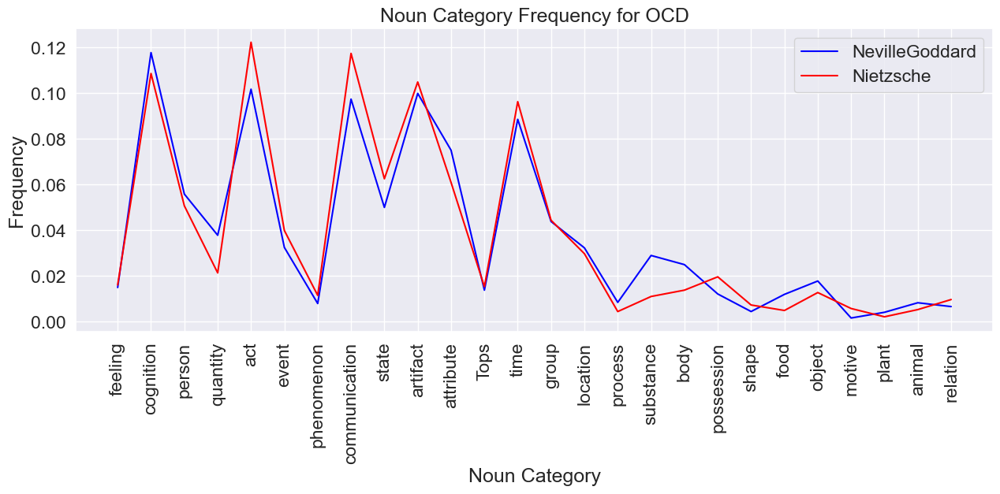

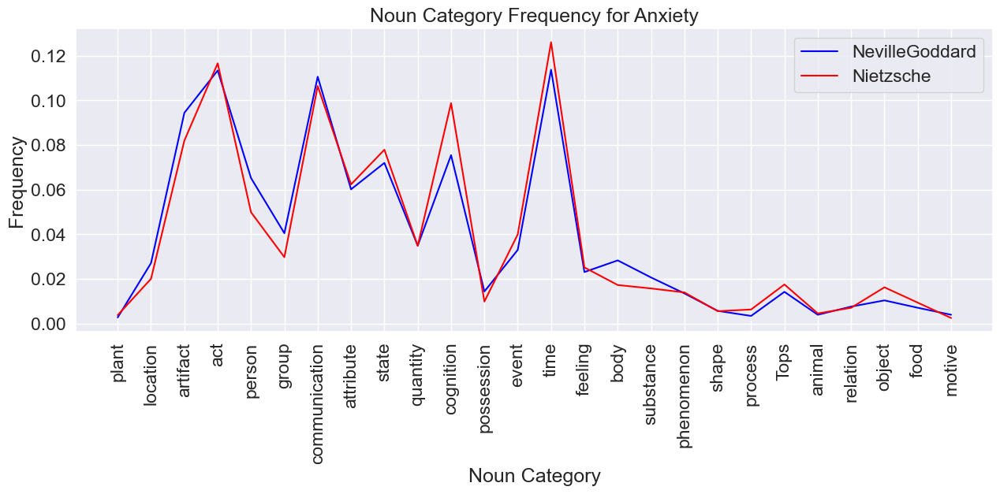

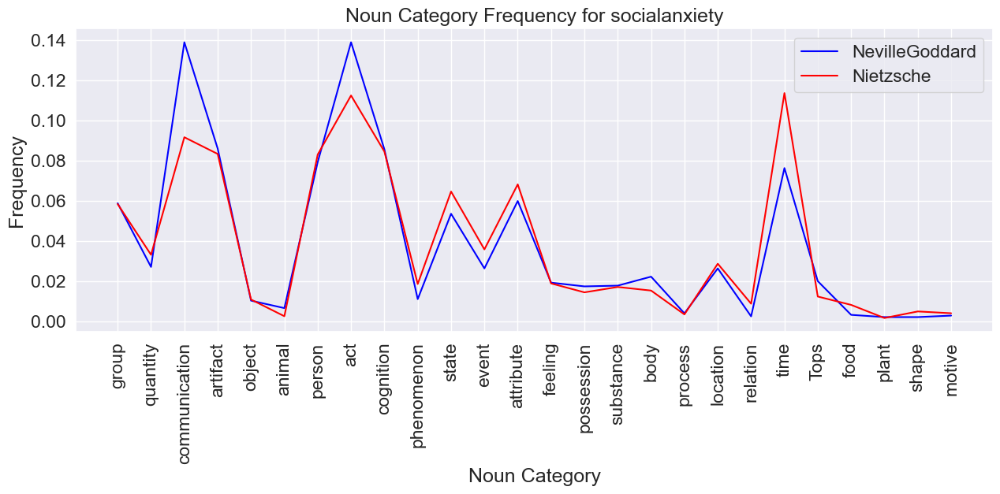

In [20]:
for sub in selected_subs:
    
    noun_df_1 = noun_count(df_subreddit_1[df_subreddit_1["subreddit"] == sub]) 
    noun_df_1["Frequency"] = noun_df_1["Count"]/noun_df_1["Count"].sum()
    
    noun_df_2 = noun_count(df_subreddit_2[df_subreddit_2["subreddit"] == sub])
    noun_df_2["Frequency"] = noun_df_2["Count"]/noun_df_2["Count"].sum()
    
    fig = plt.figure(figsize=(15,5))
    ax = fig.add_subplot(111)
    ax.set_title(f"Noun Category Frequency for {sub}")
    sns.lineplot(data = noun_df_1, x = "Noun Category", y= 'Frequency', ax = ax, label = f"{subreddit_1}", color = 'blue')
    sns.lineplot(data = noun_df_2, x = "Noun Category", y= 'Frequency', ax = ax, label = f"{subreddit_2}", color = 'red')
    sns.set(font_scale=1.5)
    plt.legend()
    plt.xticks(rotation=90)
    plt.show()

## SFA Comparison

In [21]:
for sub in selected_subs:
    
    df_1 = df_subreddit_1[df_subreddit_1["subreddit"] == sub]
    df_2 = df_subreddit_2[df_subreddit_2["subreddit"] == sub]
    df_sfa_1 = sfa_metrics(df_1)
    df_sfa_2 = sfa_metrics(df_2)
    
    print(f"Subreddit {sub}:")
    print(f"  {subreddit_1} Percentage of SFA = {df_sfa_1['Percentage of SFA']: .2%}")
    print(f"  {subreddit_2} Percentage of SFA = {df_sfa_2['Percentage of SFA']: .2%}")
    print("\n")


Subreddit ADHD:
  NevilleGoddard Percentage of SFA =  7.69%
  Nietzsche Percentage of SFA =  7.74%


Subreddit depression:
  NevilleGoddard Percentage of SFA =  7.50%
  Nietzsche Percentage of SFA =  7.59%


Subreddit BPD:
  NevilleGoddard Percentage of SFA =  7.58%
  Nietzsche Percentage of SFA =  7.25%


Subreddit socialskills:
  NevilleGoddard Percentage of SFA =  7.22%
  Nietzsche Percentage of SFA =  7.30%


Subreddit SuicideWatch:
  NevilleGoddard Percentage of SFA =  7.52%
  Nietzsche Percentage of SFA =  7.51%


Subreddit CPTSD:
  NevilleGoddard Percentage of SFA =  7.21%
  Nietzsche Percentage of SFA =  7.70%


Subreddit raisedbynarcissists:
  NevilleGoddard Percentage of SFA =  7.35%
  Nietzsche Percentage of SFA =  7.70%


Subreddit NarcissisticAbuse:
  NevilleGoddard Percentage of SFA =  7.46%
  Nietzsche Percentage of SFA =  7.49%


Subreddit OCD:
  NevilleGoddard Percentage of SFA =  8.12%
  Nietzsche Percentage of SFA =  7.32%


Subreddit Anxiety:
  NevilleGoddard Percen

## Emotion Change

In [22]:
df_subreddit_1.drop(['index'], axis = 1, inplace = True)
df_subreddit_2.drop(['index'], axis = 1, inplace = True)

In [23]:
columns = list(df_subreddit_1.columns[6:])
alpha = 0.05

for sub in selected_subs:
    df_1 = df_subreddit_1[df_subreddit_1['subreddit']== sub]
    df_2 = df_subreddit_2[df_subreddit_2['subreddit']== sub]
    
    grouped_1 = get_aggregated_df(df_1, columns)
    grouped_2 = get_aggregated_df(df_2, columns)
    
    df_change_data_1 = get_authors_change_data(columns, grouped_1)
    df_change_data_2 = get_authors_change_data(columns, grouped_2)
    
    mannwhitney_df_two_sided = mann_whitney_u_test(df_change_data_1, df_change_data_2, "two-sided")
    mannwhitney_df_two_sided = mannwhitney_df_two_sided[mannwhitney_df_two_sided['pvalue'] < alpha]
    
    mannwhitney_df_less = mann_whitney_u_test(df_change_data_1, df_change_data_2, "less")
    mannwhitney_df_less = mannwhitney_df_less[mannwhitney_df_less['pvalue'] < alpha]
    
    mannwhitney_df_greater = mann_whitney_u_test(df_change_data_1, df_change_data_2, "greater")
    mannwhitney_df_greater = mannwhitney_df_greater[mannwhitney_df_greater['pvalue'] < alpha]
    
    df_change_data_1 = df_change_data_1.assign(Subreddit = subreddit_1)
    df_change_data_2 = df_change_data_2.assign(Subreddit = subreddit_2)
    
    cdf = pd.concat([df_change_data_1, df_change_data_2]) 
    mdf = pd.melt(cdf, id_vars=['Subreddit'], var_name=['Number'])      
    
    print(f"Subreddit {sub}: ")
    print("\n")
    
    print("  Significant variables list - Two tailed Mann-Whitney U-Test")
    print("  ", mannwhitney_df_two_sided)
    print("\n")
    
    
    print(f"  Categories where {subreddit_1} is likely to have lesser values than {subreddit_2} - One tailed Mann-Whitney U-Test")
    print(mannwhitney_df_less)
    print("\n")
    
    print(f"  Categories where {subreddit_1} is likely to have greater values than {subreddit_2} - One tailed Mann-Whitney U-Test")
    print(mannwhitney_df_greater)
    print("\n")
    
    

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 72/72 [00:10<00:00,  6.79it/s]


Subreddit ADHD: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                   statistic    pvalue
emp_heroic         1587.0  0.020051
emp_work           1461.0  0.024265
emp_death          1537.5  0.034372
emp_home           1555.5  0.039486
emp_shopping       1576.0  0.041377
emp_crime          1605.0  0.041555
emp_occupation     1548.5  0.042678
emp_poor           1602.0  0.046627


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
                  statistic    pvalue
emp_heroic           1587.0  0.010025
emp_work             1461.0  0.012132
emp_death            1537.5  0.017186
emp_home             1555.5  0.019743
emp_shopping         1576.0  0.020689
emp_crime            1605.0  0.020778
emp_occupation       1548.5  0.021339
emp_poor             1602.0  0.023314
emp_noise            1579.0  0.025186
emp_rural            1622.0  0.031455
emp_night            1624.5  0.038950
emp_morning         

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 79/79 [00:11<00:00,  6.72it/s]


Subreddit depression: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                       statistic    pvalue
Polarity               2425.5  0.009628
Subjectivity           2425.5  0.009628
emp_kill               2330.0  0.014503
emp_speaking           1686.0  0.027386
emp_payment            2262.5  0.028294
emp_magic              2179.0  0.031482
emp_shopping           2179.0  0.031482
emp_money              2291.0  0.032202
emp_banking            2239.0  0.040200
emp_disappointment     2228.0  0.043119


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
              statistic    pvalue
emp_speaking     1686.0  0.013693


  Categories where NevilleGoddard is likely to have greater values than Nietzsche - One tailed Mann-Whitney U-Test
                    statistic    pvalue
Polarity               2425.5  0.004814
Subjectivity           2425.5  0.004814
emp_kill               2330.0  0.007252
emp_payme

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:03<00:00,  6.87it/s]


Subreddit BPD: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                         statistic    pvalue
emp_stealing              474.0  0.001410
emp_prison                442.0  0.006213
emp_ugliness              264.0  0.008913
emp_blue_collar_job       427.0  0.014623
emp_crime                 438.0  0.018639
emp_zest                  429.0  0.026853
emp_business              452.0  0.027724
emp_fight                 446.0  0.030191
emp_lust                  440.0  0.042361
emp_giving                449.0  0.046426
emp_white_collar_job      435.5  0.047799
emp_occupation            435.5  0.047799
emp_timidity              435.0  0.049140
emp_car                   402.0  0.049810
emp_warmth                402.0  0.049810


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
                  statistic    pvalue
emp_ugliness          264.0  0.004457
emp_hate              257.0  0.028079
emp_irritabilit

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:08<00:00,  6.29it/s]


Subreddit socialskills: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                  statistic    pvalue
emp_valuable       988.0  0.032645
emp_competing      988.0  0.032645


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
                statistic    pvalue
emp_valuable        988.0  0.016322
emp_competing       988.0  0.016322
emp_musical        1000.0  0.030408
emp_gain           1014.0  0.035717
emp_fabric         1014.0  0.035717
emp_rural          1014.0  0.035717
emp_banking        1014.0  0.035717
emp_computer       1004.5  0.037807
emp_fear            970.0  0.041602
emp_appearance      983.0  0.042243


  Categories where NevilleGoddard is likely to have greater values than Nietzsche - One tailed Mann-Whitney U-Test
           statistic    pvalue
nrc_anger     1235.5  0.041882




100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:07<00:00,  7.03it/s]


Subreddit SuicideWatch: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                 statistic    pvalue
emp_giving       1206.5  0.029565
emp_ugliness     1317.0  0.045990


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
                          statistic    pvalue
emp_giving                   1206.5  0.014782
emp_ugliness                 1317.0  0.022995
emp_horror                   1300.0  0.028627
emp_dominant_personality     1372.0  0.035658
emp_children                 1251.5  0.037322
emp_trust                    1258.0  0.042188


  Categories where NevilleGoddard is likely to have greater values than Nietzsche - One tailed Mann-Whitney U-Test
                      statistic    pvalue
nrc_negative             1693.0  0.029551
emp_positive_emotion     1680.0  0.031473
emp_fight                1626.0  0.041512
emp_prison               1606.0  0.046015
emp_cooking              1534.0  0.047078

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:04<00:00,  6.75it/s]


Subreddit CPTSD: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                    statistic    pvalue
emp_fashion          357.5  0.014694
emp_celebration      353.0  0.023671
emp_car              543.5  0.034162
emp_home             575.0  0.035341
emp_philosophy       361.5  0.043281
emp_rural            555.5  0.044654
emp_warmth           539.0  0.045449
emp_movement         566.0  0.047490


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
                 statistic    pvalue
emp_fashion          357.5  0.007347
emp_celebration      353.0  0.011835
emp_philosophy       361.5  0.021641
emp_payment          391.0  0.032623
emp_anger            371.0  0.033700
emp_plant            386.5  0.039246
emp_contentment      364.5  0.043595
emp_love             360.0  0.043714
emp_fight            372.0  0.047047


  Categories where NevilleGoddard is likely to have greater values than Nietzsche - One tailed

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:03<00:00,  6.89it/s]


Subreddit raisedbynarcissists: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                     statistic    pvalue
emp_sympathy          690.5  0.009427
emp_hearing           711.5  0.010086
emp_dispute           702.0  0.012961
emp_violence          691.5  0.027618
nrc_anticipation      446.0  0.028998
emp_love              681.0  0.044610


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
                  statistic    pvalue
nrc_anticipation      446.0  0.014499


  Categories where NevilleGoddard is likely to have greater values than Nietzsche - One tailed Mann-Whitney U-Test
                 statistic    pvalue
emp_sympathy         690.5  0.004713
emp_hearing          711.5  0.005043
emp_dispute          702.0  0.006481
emp_violence         691.5  0.013809
emp_love             681.0  0.022305
emp_ocean            628.0  0.027286
emp_politeness       628.0  0.027286
emp_water            628.0  0.

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:01<00:00,  6.34it/s]


Subreddit NarcissisticAbuse: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                     statistic    pvalue
emp_irritability       75.0  0.015015


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
                          statistic    pvalue
emp_irritability               75.0  0.007507
emp_dominant_personality       91.0  0.034190
emp_art                        85.0  0.041873
emp_exotic                    108.0  0.047668


  Categories where NevilleGoddard is likely to have greater values than Nietzsche - One tailed Mann-Whitney U-Test
              statistic    pvalue
emp_pride         158.0  0.028499
emp_gain          157.0  0.032124
emp_exercise      151.0  0.039057
emp_monster       145.0  0.039835




100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:03<00:00,  6.89it/s]


Subreddit OCD: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                statistic    pvalue
emp_zest         265.0  0.028564
emp_hate         275.5  0.032017
emp_science      260.0  0.032271
emp_vehicle      260.0  0.032271
emp_pet          257.0  0.045030


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
                      statistic    pvalue
emp_horror                160.0  0.031685
emp_musical               165.0  0.031784
emp_law                   176.0  0.035067
emp_white_collar_job      172.5  0.048142


  Categories where NevilleGoddard is likely to have greater values than Nietzsche - One tailed Mann-Whitney U-Test
             statistic    pvalue
emp_zest         265.0  0.014282
emp_hate         275.5  0.016008
emp_science      260.0  0.016135
emp_vehicle      260.0  0.016135
emp_pet          257.0  0.022515
emp_magic        255.0  0.027857
emp_car          260.0  0.031784
emp_warmth  

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:03<00:00,  7.03it/s]


Subreddit Anxiety: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                   statistic    pvalue
emp_horror          425.0  0.031778
emp_computer        448.0  0.046306
emp_attractive      581.0  0.046845


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
                 statistic    pvalue
emp_horror           425.0  0.015889
emp_computer         448.0  0.023153
emp_school           462.0  0.038775
emp_celebration      451.0  0.039691


  Categories where NevilleGoddard is likely to have greater values than Nietzsche - One tailed Mann-Whitney U-Test
                statistic    pvalue
emp_attractive      581.0  0.023422
emp_youth           592.0  0.035191
emp_feminine        568.0  0.035645
emp_healing         600.0  0.036086
emp_children        594.5  0.046801




100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:02<00:00,  7.00it/s]


Subreddit socialanxiety: 


  Significant variables list - Two tailed Mann-Whitney U-Test
                         statistic    pvalue
emp_morning               192.0  0.031635
emp_white_collar_job      191.5  0.033855
emp_divine                187.0  0.038688
emp_youth                 197.0  0.045171


  Categories where NevilleGoddard is likely to have lesser values than Nietzsche - One tailed Mann-Whitney U-Test
           statistic    pvalue
emp_water      126.0  0.041045


  Categories where NevilleGoddard is likely to have greater values than Nietzsche - One tailed Mann-Whitney U-Test
                      statistic    pvalue
emp_morning               192.0  0.015817
emp_white_collar_job      191.5  0.016927
emp_divine                187.0  0.019344
emp_youth                 197.0  0.022586
emp_deception             185.0  0.025730
emp_politeness            185.0  0.025730
emp_affection             185.0  0.025730
emp_poor                  185.0  0.025730
emp_feminine            

## Trend Analysis

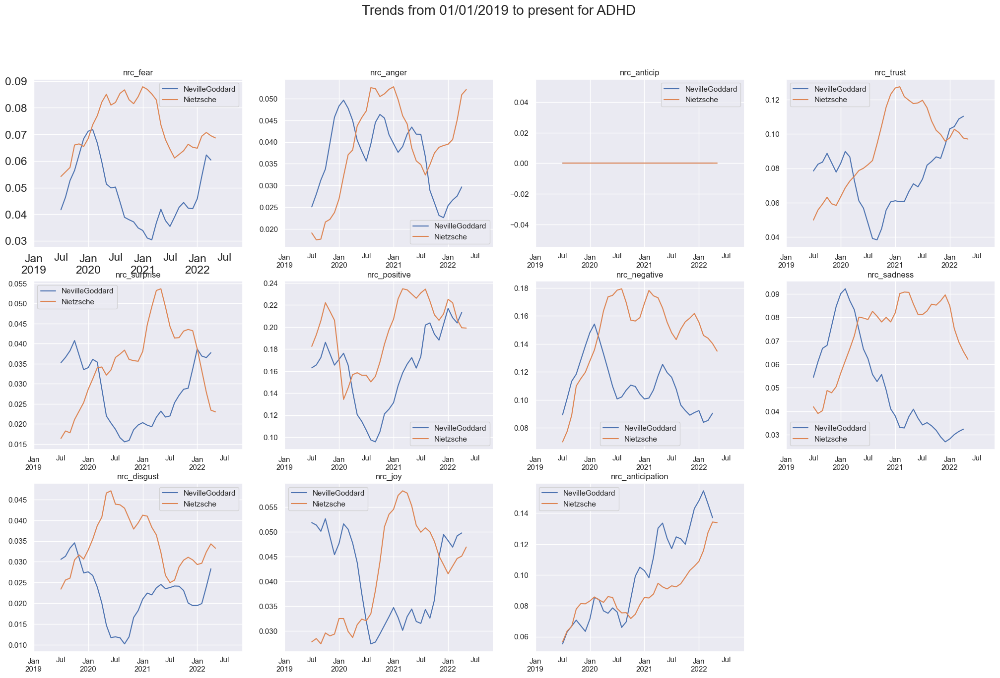

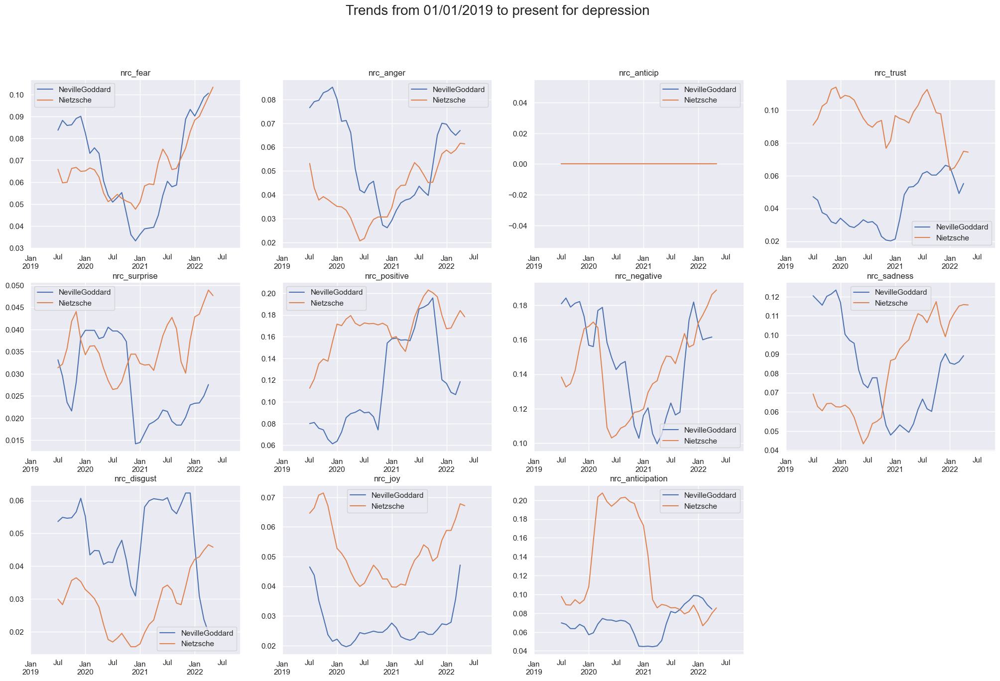

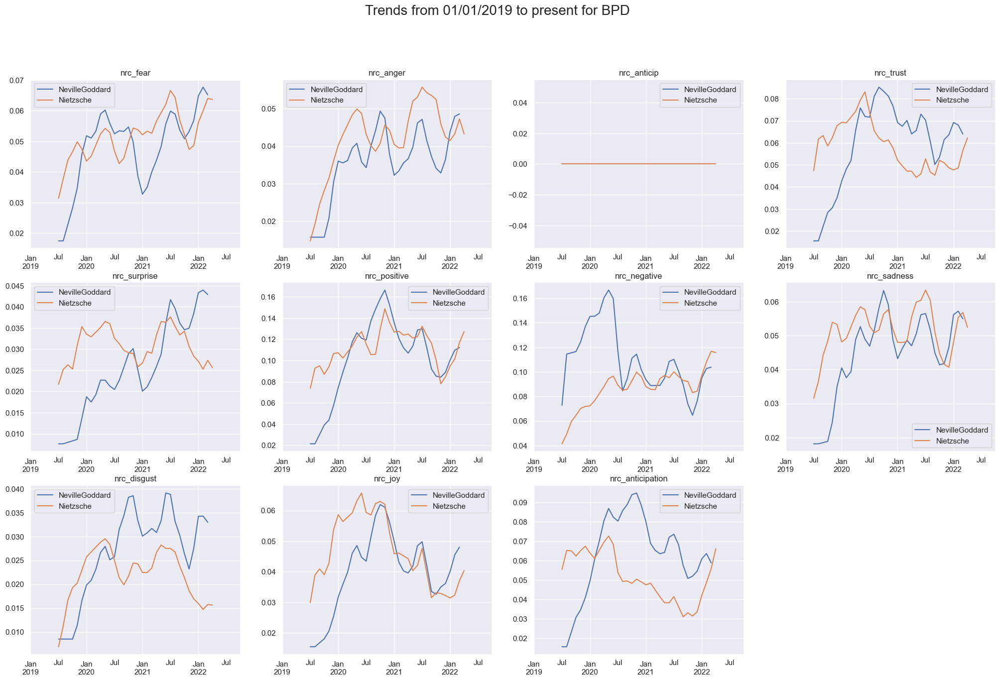

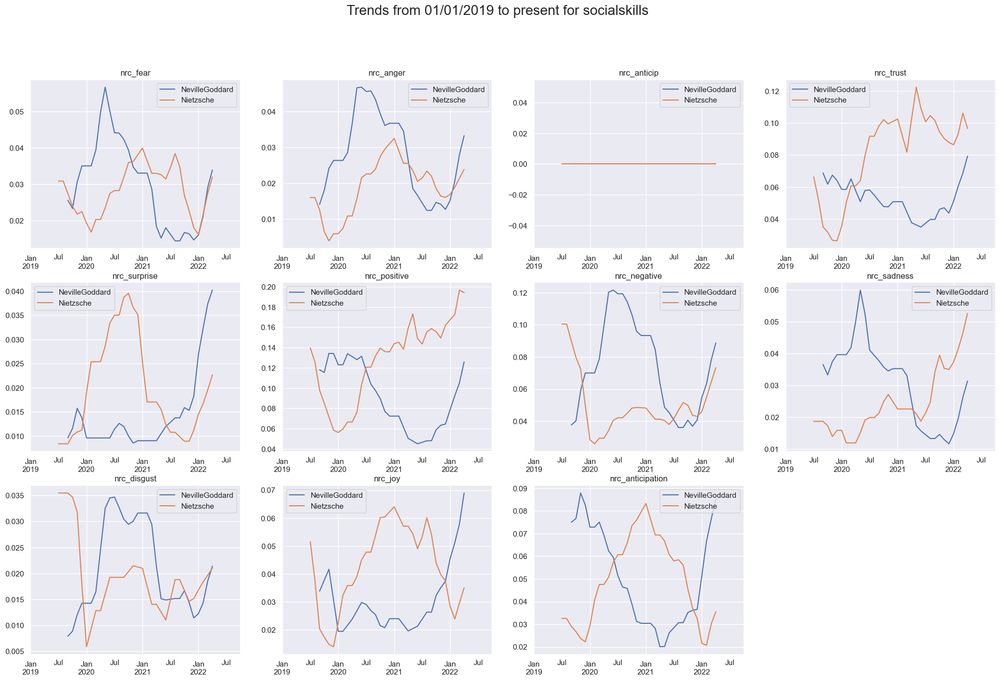

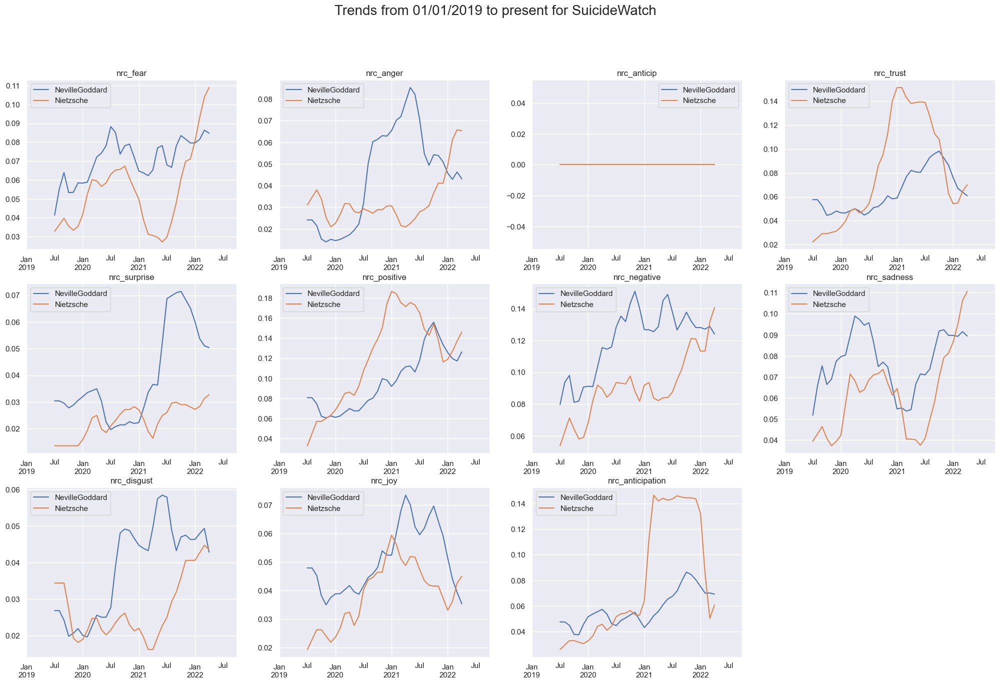

...

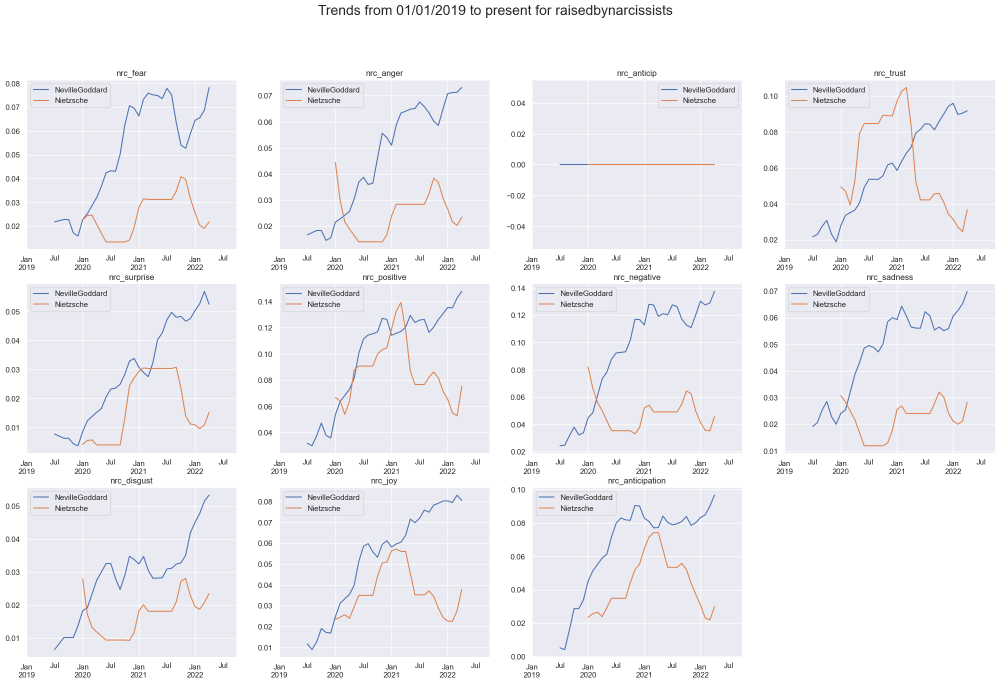

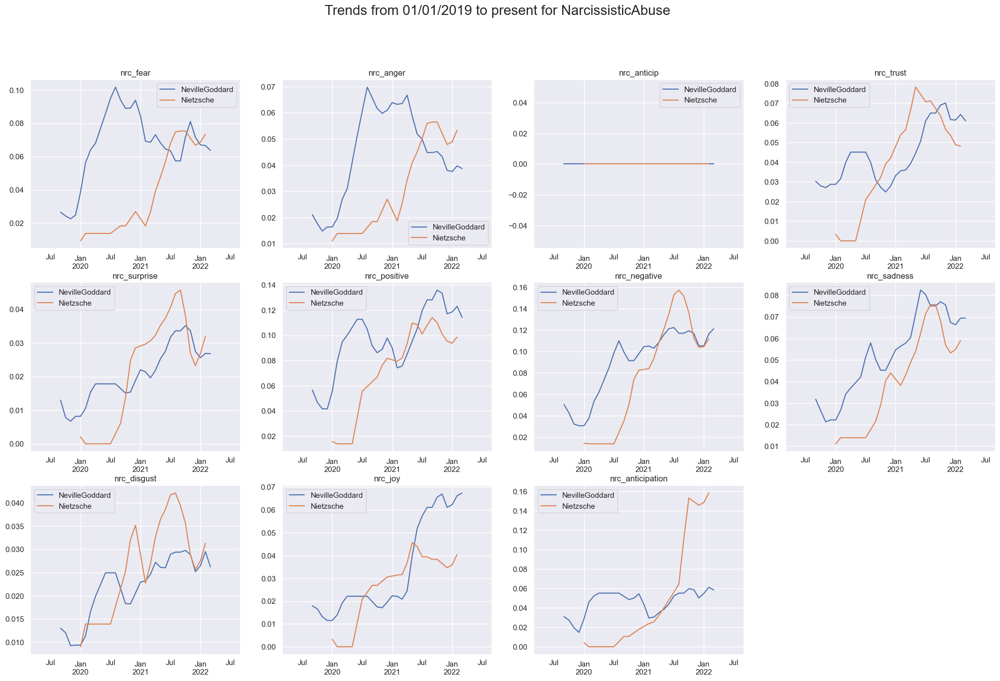

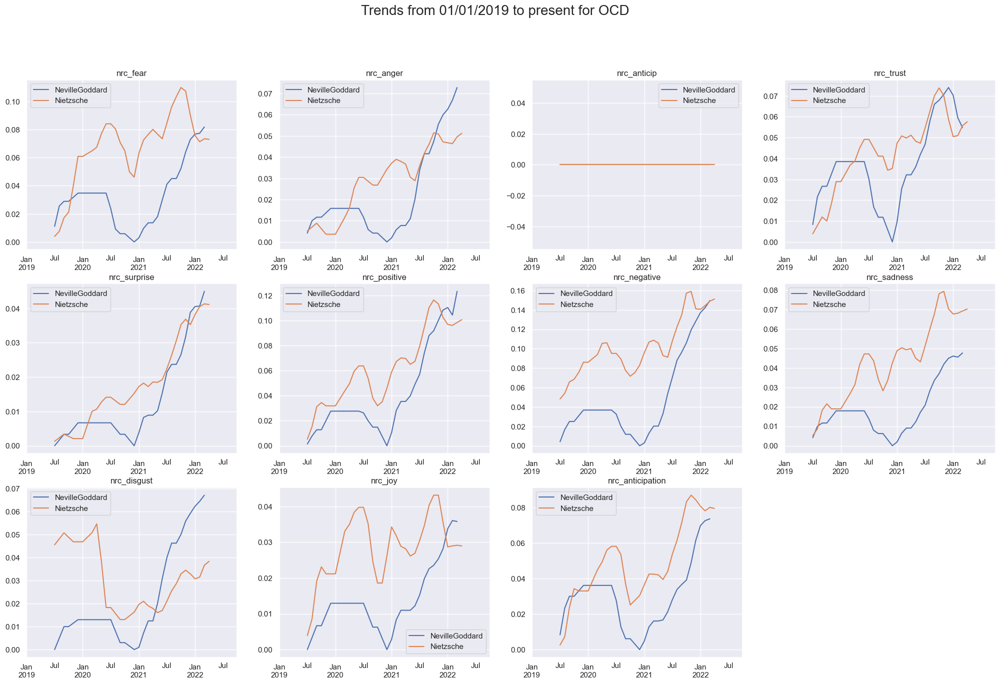

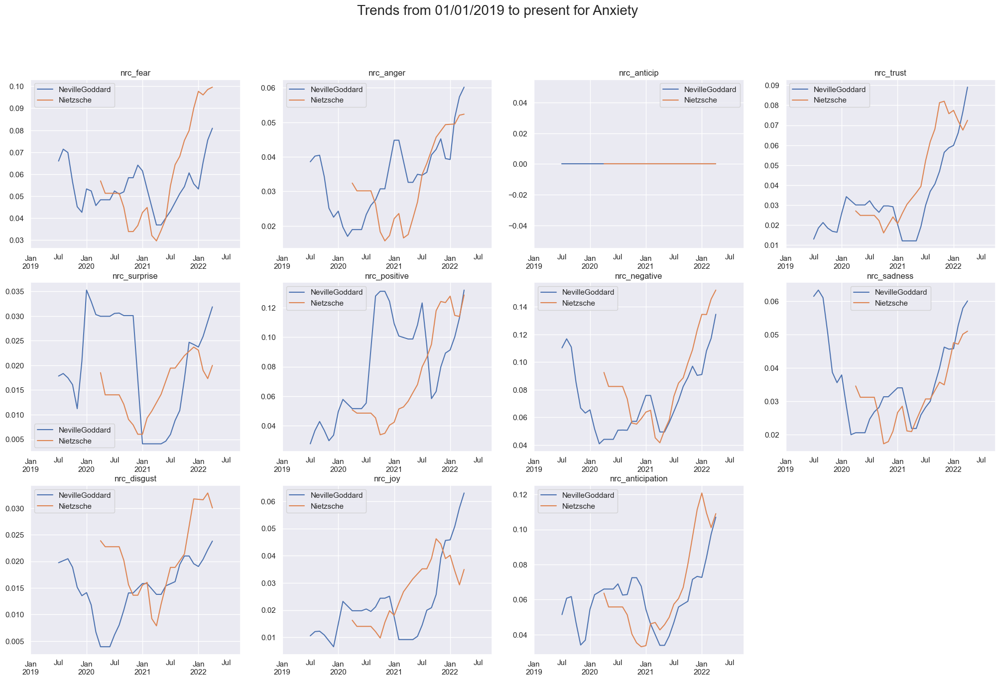

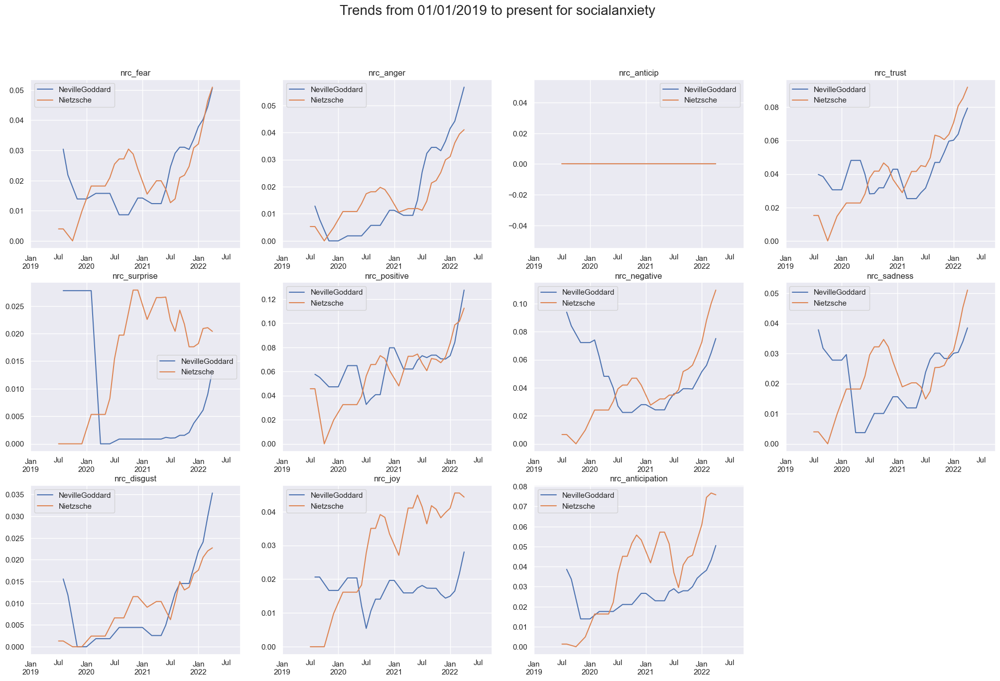

In [24]:
for sub in selected_subs:
    
    fig = plt.figure(figsize = (25,15))
    fig.suptitle(f"Trends from 01/01/2019 to present for {sub}", fontsize = 20)
    
    df_1 = df_subreddit_1[df_subreddit_1['subreddit'] == sub]
    df_2 = df_subreddit_2[df_subreddit_2['subreddit'] == sub]
    
    aggregated_df_1 = get_time_aggregated_df(df_1, df_1.columns[-11:])
    aggregated_df_1 = aggregated_df_1.fillna(value = 0)
    aggregated_df_1 = aggregated_df_1.set_index('isodate')

    aggregated_df_2 = get_time_aggregated_df(df_2, df_2.columns[-11:])
    aggregated_df_2 = aggregated_df_2.fillna(value = 0)
    aggregated_df_2 = aggregated_df_2.set_index('isodate')
    
    aggregated_df_1_2019 =  aggregated_df_1[datetime(2019, 1, 1) <= aggregated_df_1.index]
    aggregated_df_2_2019 =  aggregated_df_2[datetime(2019, 1, 1) <= aggregated_df_2.index]
    
    aggregated_df_1.index = add_freq(aggregated_df_1.index)
    aggregated_df_2.index = add_freq(aggregated_df_2.index)
    

    
    i=1
    for col in df_subreddit_1.columns[-11:]:
        decomposition_1 = sm.tsa.seasonal_decompose(aggregated_df_1_2019[col], model = "additive")
        decomposition_2 = sm.tsa.seasonal_decompose(aggregated_df_2_2019[col], model = "additive")

        ax = plt.subplot(3,4,i)
        decomposition_1.trend.plot(label = f"{subreddit_1}")
        decomposition_2.trend.plot(label = f"{subreddit_2}")
        sns.set(font_scale=1)
        ax.legend()
        ax.set_title(col)
        ax.set(xlabel=None)
        ax.set(ylabel=None)

        i+=1